In [1]:
import math
import sys
import os
sys.path.insert(0,'..')
from doe_xstock.data import CityLearnData
from citylearn.utilities import read_json
import matplotlib.pyplot as plt
from matplotlib import ticker
%matplotlib inline
import pandas as pd
import seaborn as sns
from src.utilities import DataHandler, FileHandler
import json

### Previous Notes/Questions

In [9]:
##Question: What is indoor_bulb_temperature_without_partial_load?
#is the building temperature if there were no heat pump control. 
#the temperature that would correlate with ideal load so it equals 
#the temperature time series in the building files.

In [3]:
##Question: Are occupant-thermostat interaction models being triggered ever? 
equal_rows_count = (data['indoor_dry_bulb_temperature_set_point'] == data['indoor_dry_bulb_temperature_set_point_without_control']).sum()

print("Number of rows where the two columns are equal:", equal_rows_count)

NameError: name 'data' is not defined

In [27]:
##Answer: The occupant-thermostat interaction models are being triggered and the setpoint changes.

In [2]:
#Giuseppe's work: When UNOCCUPIED: override controller action and set Q_cool to zero
#Disadvantage: The controller does not learn the occupancy and that there is flexibility when unoccupied since the occupancy 
#effect is implicit
#In our work, we want to integrate this into the reward function
#AKA IF OCCUPIED: reward = electricity consumption + discomfort 
#IF UNOCCUPIED: reward = electricity consumption ##Can play around with exponents as well for this
#Problem: Our ResStock models still appear to have very little unoccupied periods...

In [31]:
##To do: Try to run simulation for really low SPs as an example (e.g. 15 degrees C)
##to make sure that the interaction models are triggered for each Occupant Type

### Sanity Check: SP = 15 C - LOD 3

In [8]:
os.getcwd()

'/root/CityLearn/simulation/notebooks'

In [9]:
data = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022_15SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

ValueError: No objects to concatenate

In [28]:
unique_values_in_order = data['bldg_name'].unique().tolist()

In [29]:
buildings = unique_values_in_order
data = data[data['bldg_name'].isin(buildings)].copy()
data['lod'] = data['id'].str.split('-', expand=True)[0]

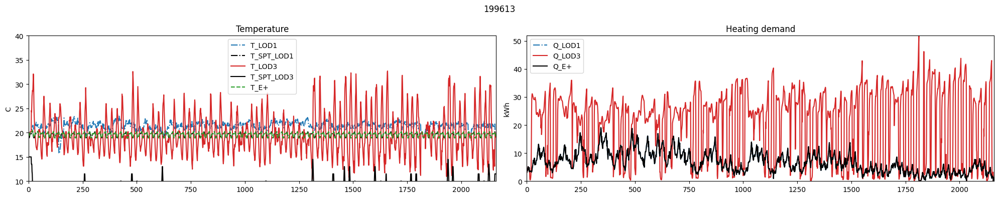

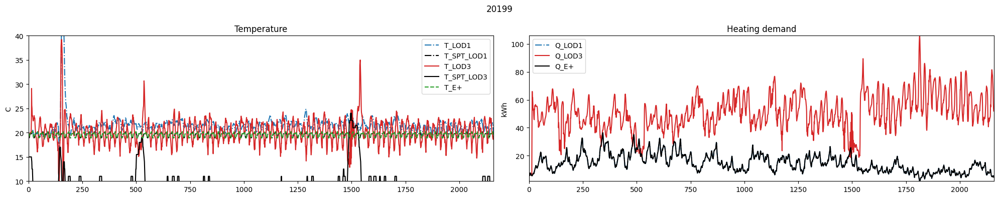

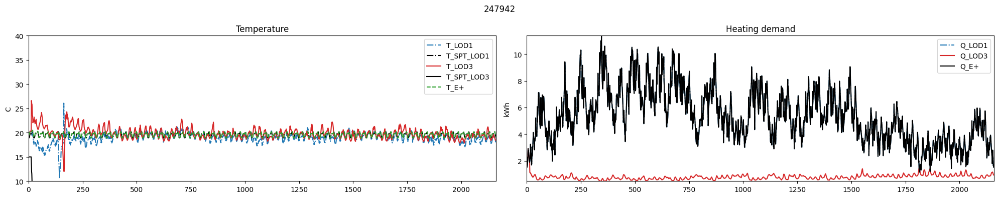

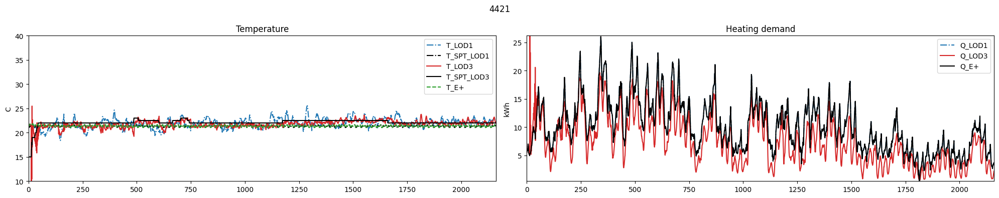

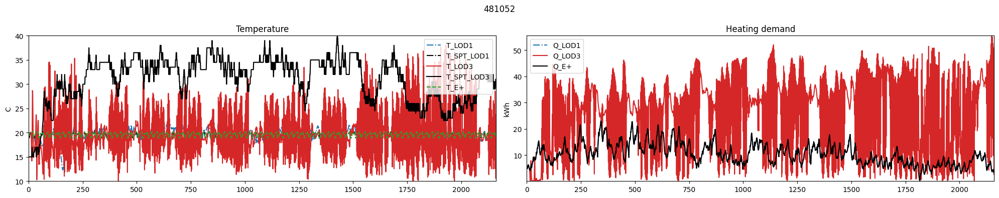

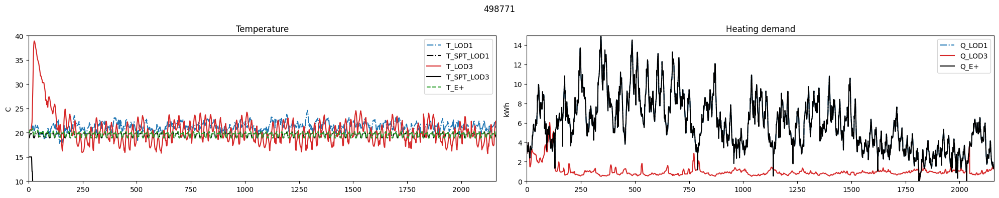

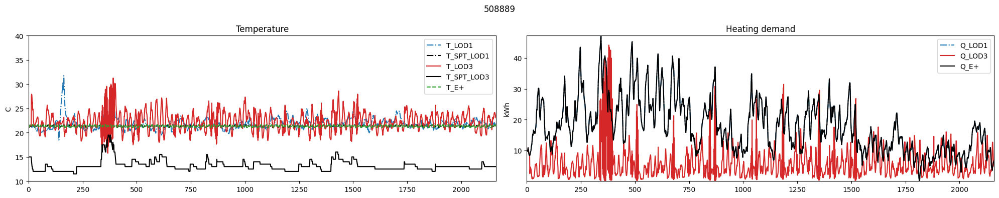

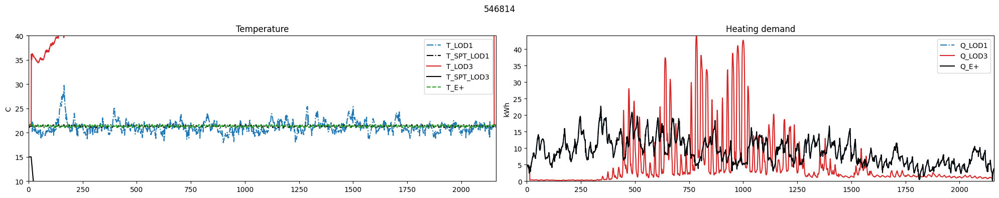

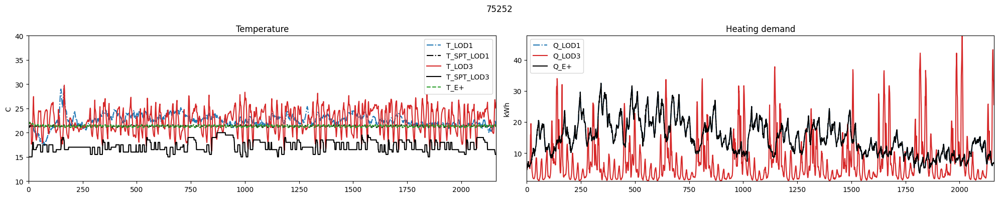

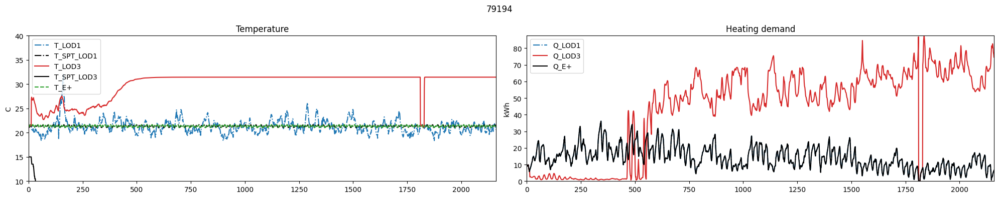

In [22]:
for b, bdata in data.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(10,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

In [23]:
data.iloc[2174,:]

bldg_name                                                                                                          20199
net_electricity_consumption                                                                                    31.554701
net_electricity_consumption_without_storage                                                                    31.554701
net_electricity_consumption_without_storage_and_partial_load                                                    6.772785
net_electricity_consumption_without_storage_and_partial_load_and_pv                                             6.772785
indoor_dry_bulb_temperature                                                                                    29.113087
indoor_dry_bulb_temperature_without_partial_load                                                               19.923748
indoor_dry_bulb_temperature_set_point                                                                               14.5
indoor_dry_bulb_temperature_set_

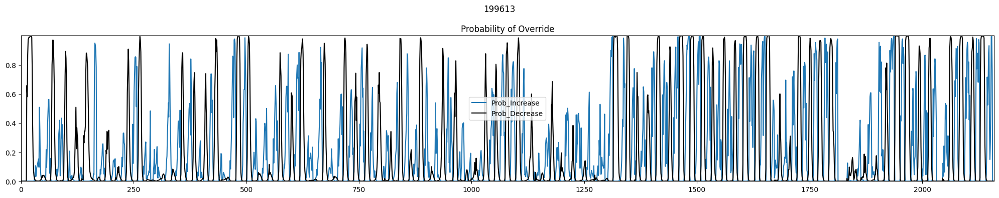

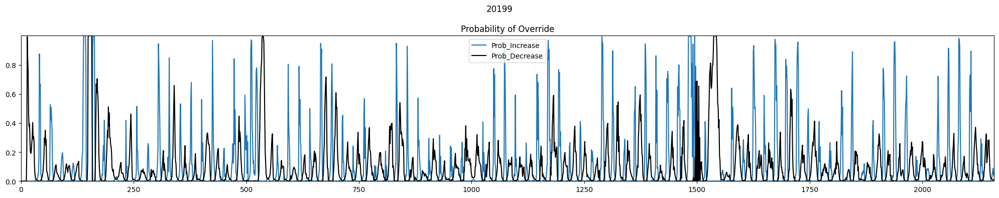

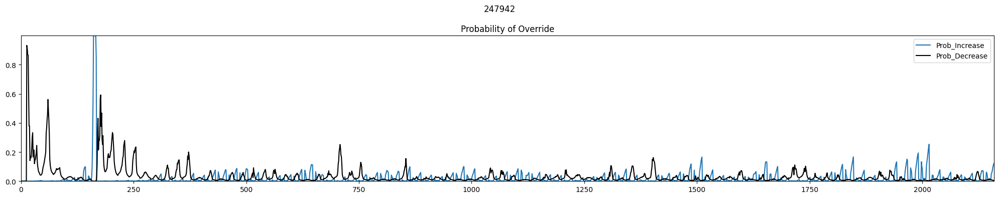

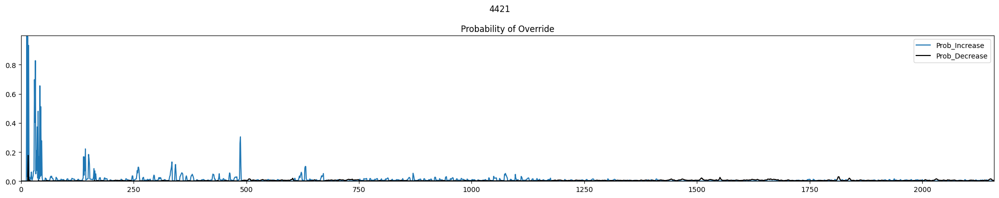

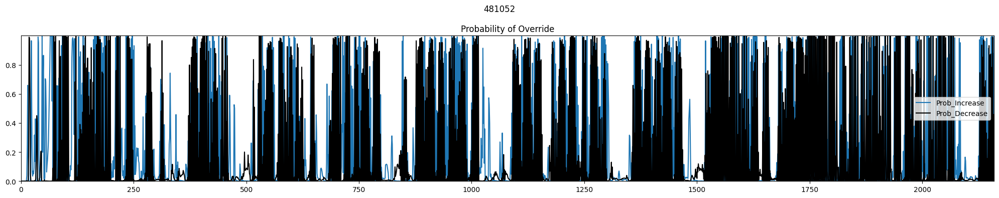

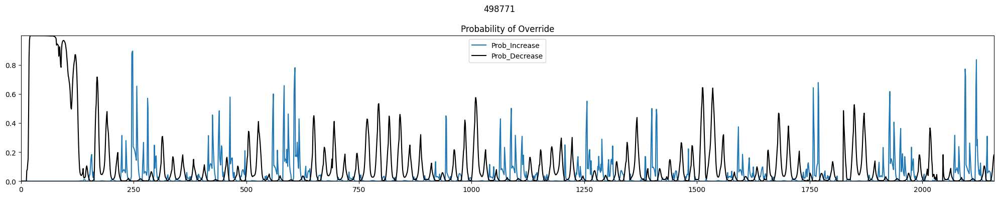

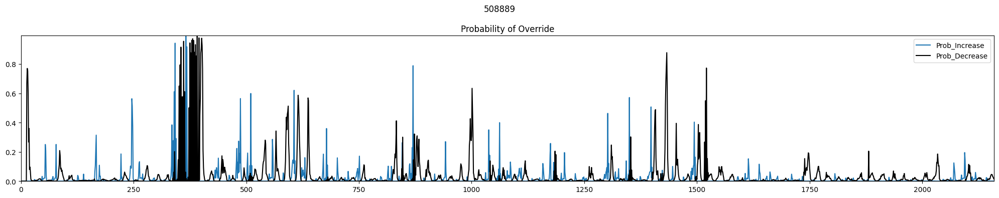

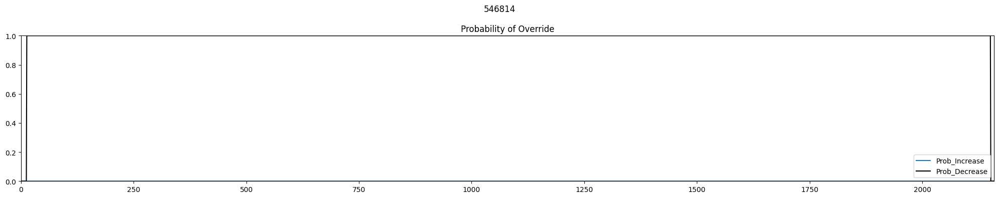

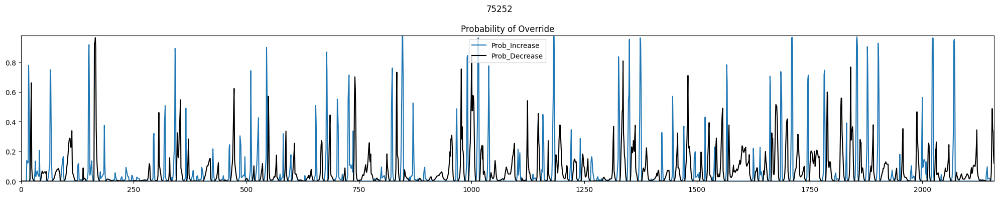

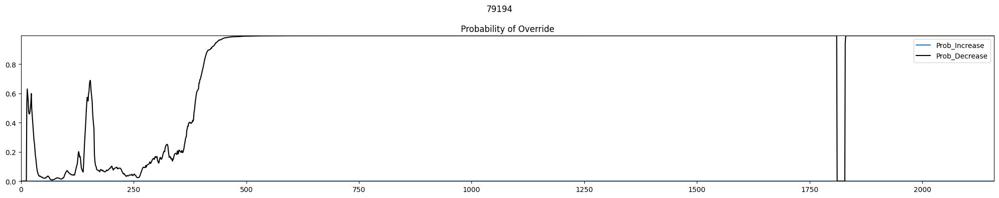

In [30]:
for b, bdata in data.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['occupant_increase_setpoint_probability'].tolist()
    y2 = lod3data['occupant_decrease_setpoint_probability'].tolist()
    fig.axes[0].plot(x, y1, label='Prob_Increase', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='Prob_Decrease', color='black') #linestyle='-.')

    fig.axes[0].set_title('Probability of Override')
    #fig.axes[0].set_ylim(10,40)
    #fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

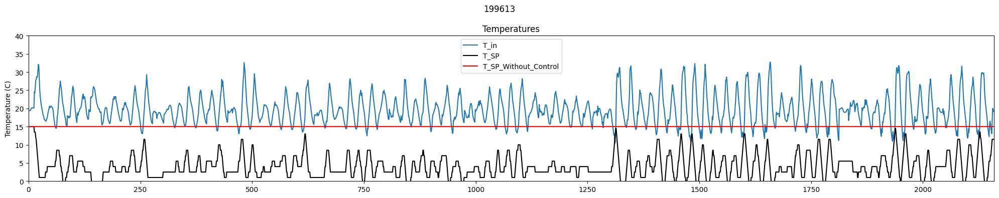

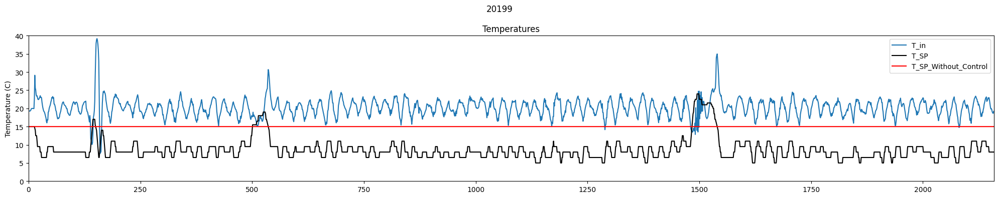

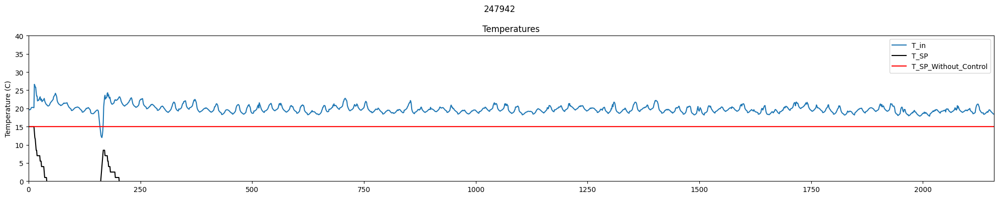

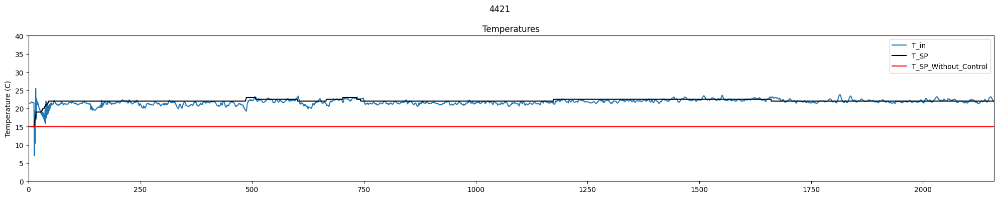

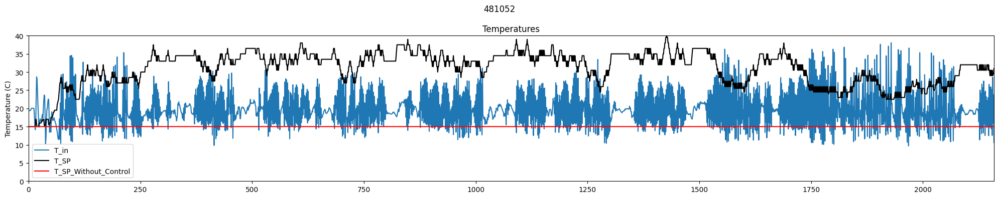

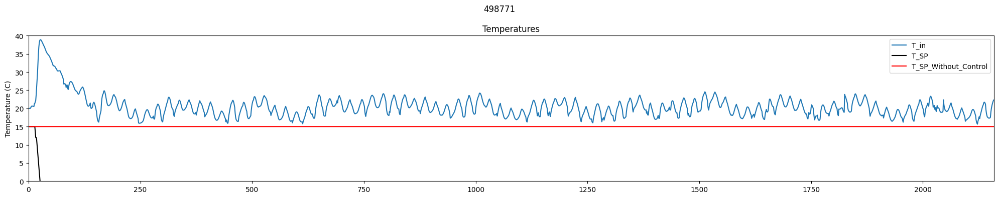

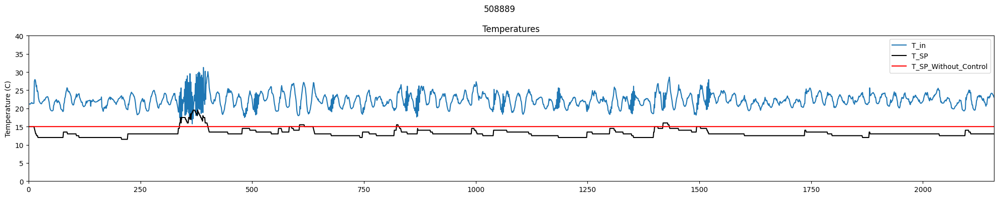

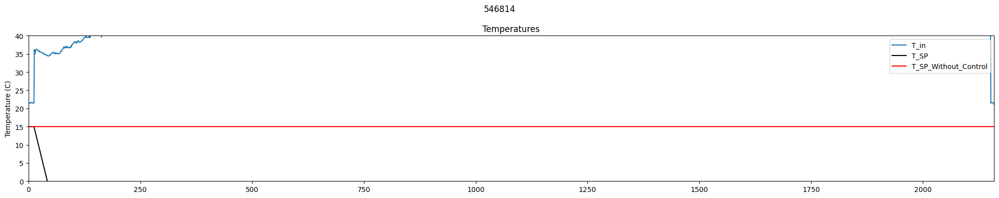

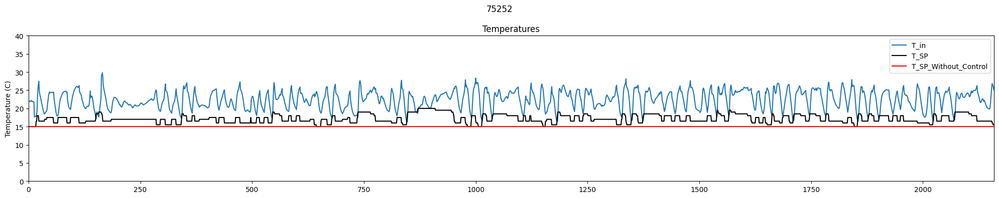

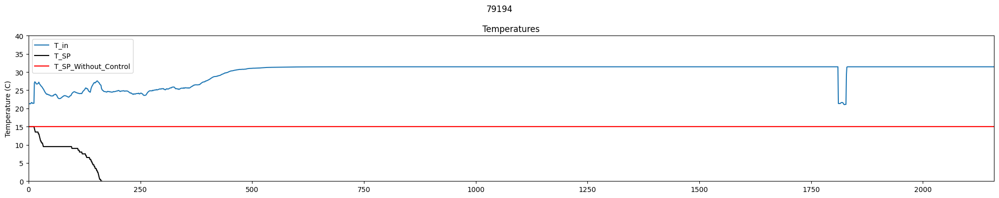

In [35]:
for b, bdata in data.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### TEST LSTM "ACCEPTABLE" BOUNDS: SP = 17 C - LOD 3

In [33]:
data_17 = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022_17SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_17 = data_17['bldg_name'].unique().tolist()

buildings_17 = unique_values_in_order_17
data_17 = data_17[data_17['bldg_name'].isin(buildings_17)].copy()
data_17['lod'] = data_17['id'].str.split('-', expand=True)[0]

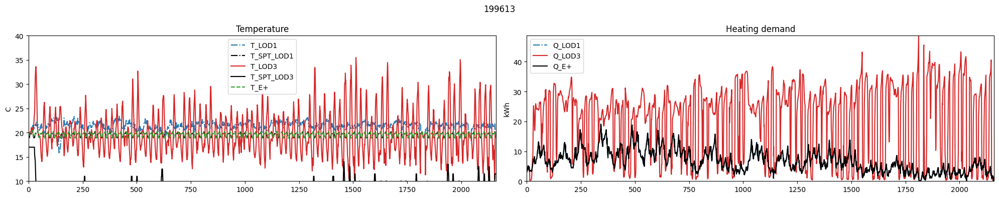

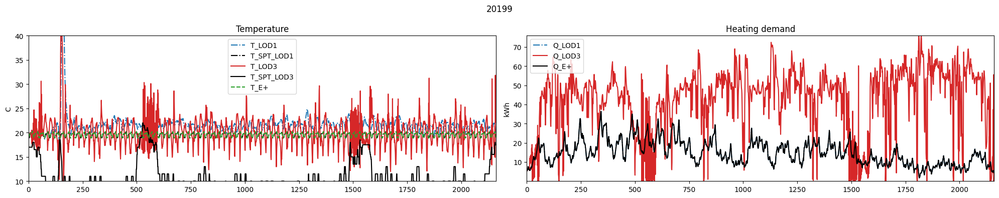

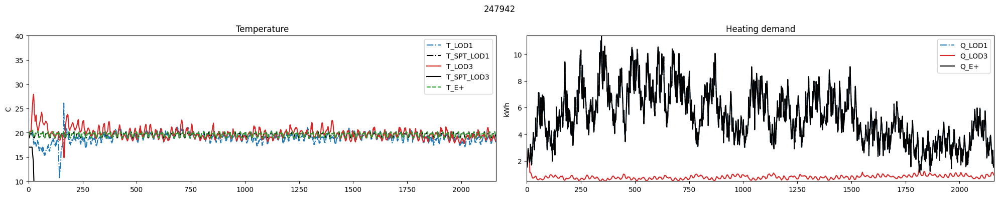

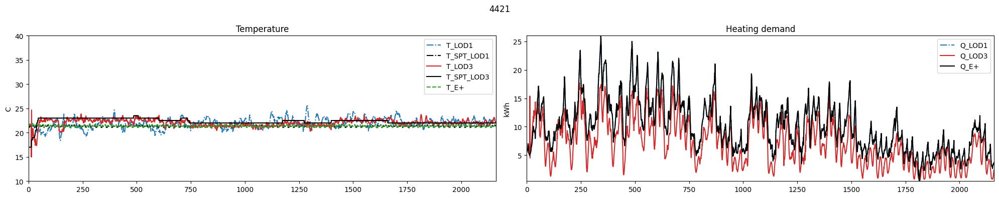

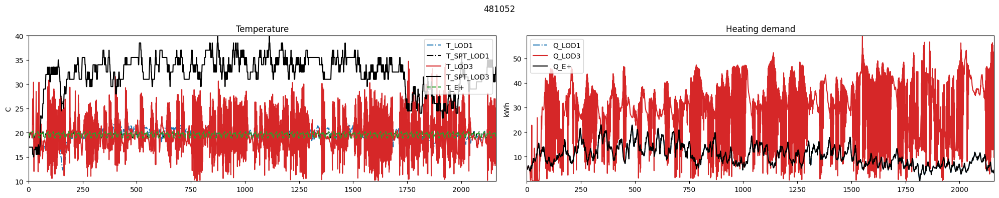

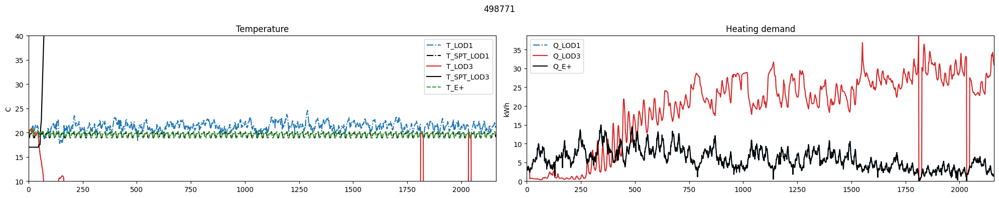

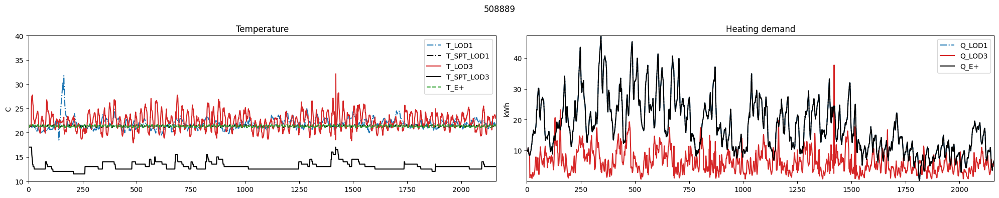

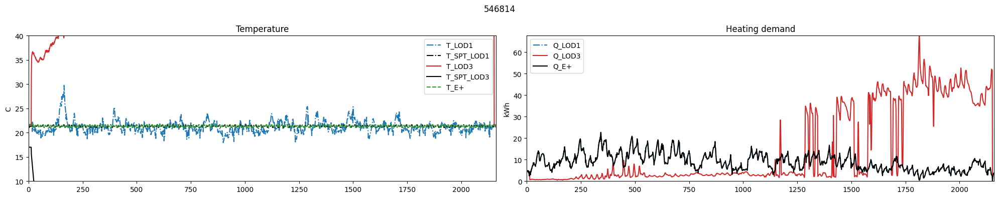

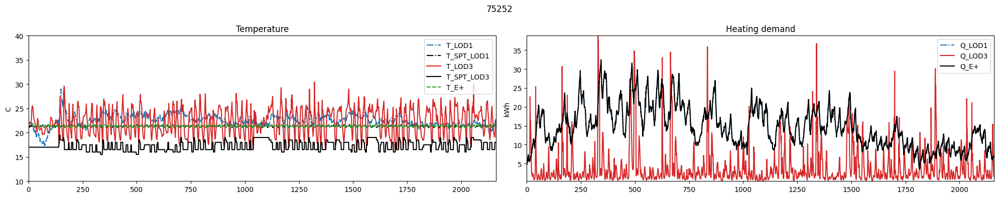

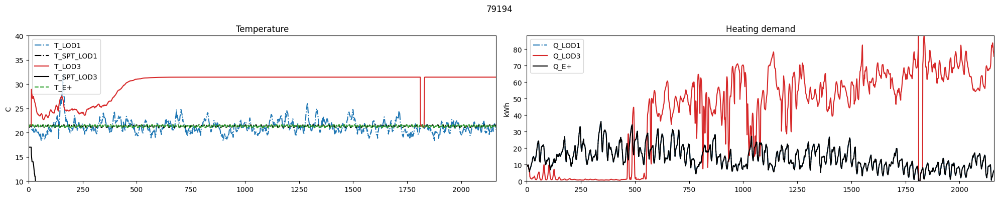

In [34]:
for b, bdata in data_17.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(10,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

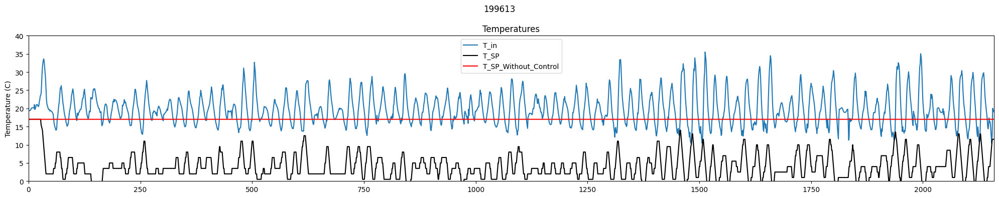

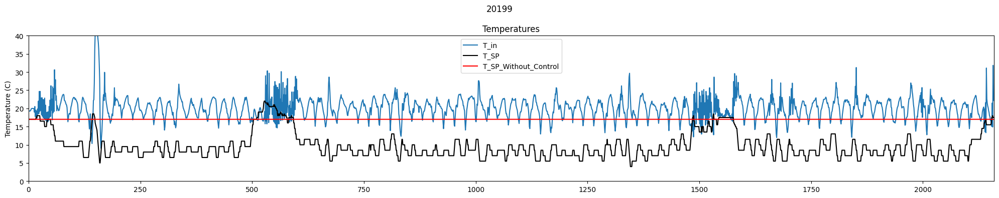

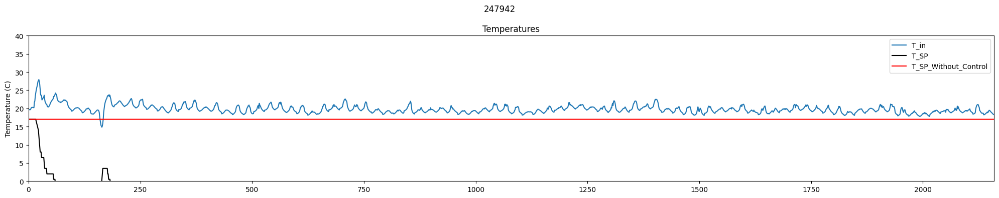

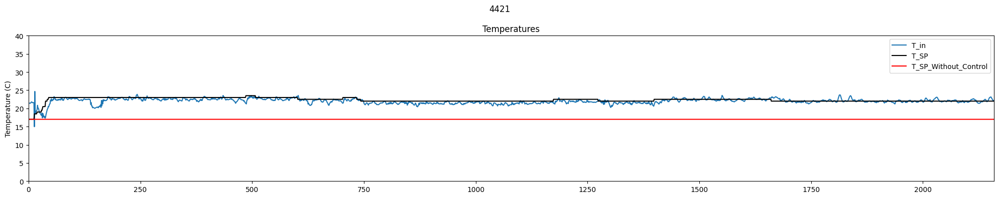

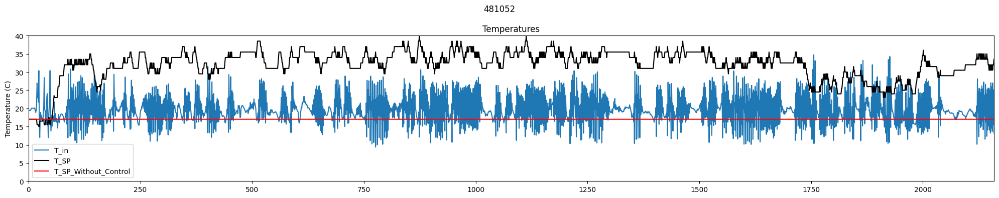

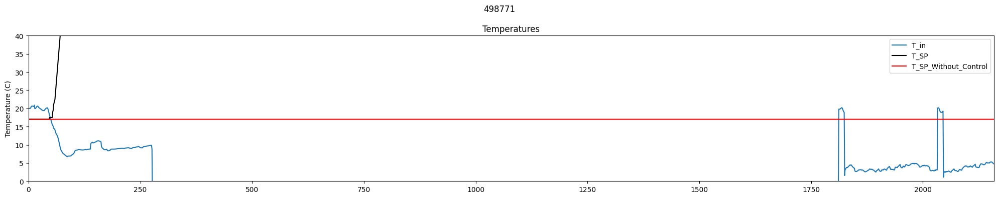

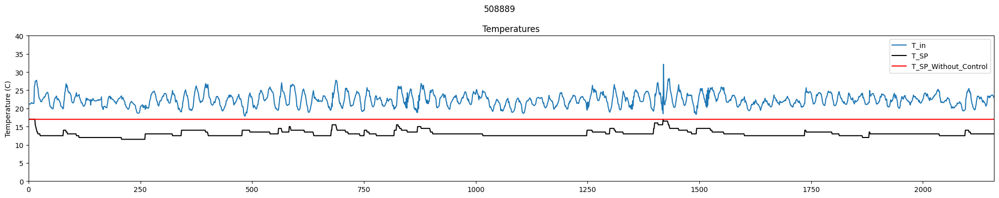

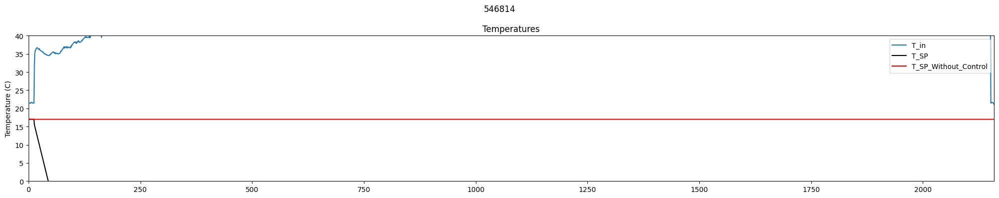

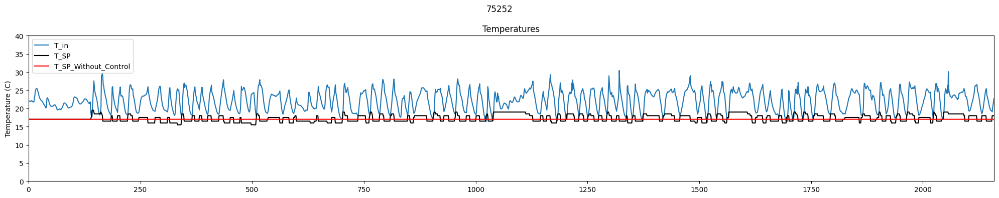

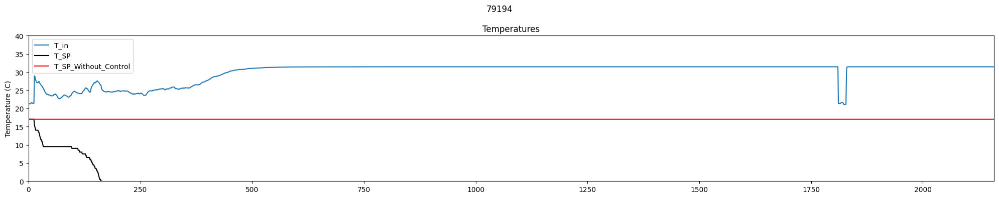

In [37]:
for b, bdata in data_17.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### TEST LSTM "ACCEPTABLE" BOUNDS: SP = 23 C - LOD 3

In [38]:
data_23 = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022_23SP.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_23 = data_23['bldg_name'].unique().tolist()

buildings_23 = unique_values_in_order_23
data_23 = data_23[data_23['bldg_name'].isin(buildings_23)].copy()
data_23['lod'] = data_23['id'].str.split('-', expand=True)[0]

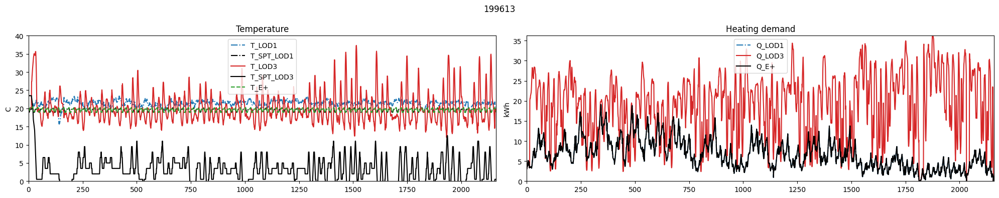

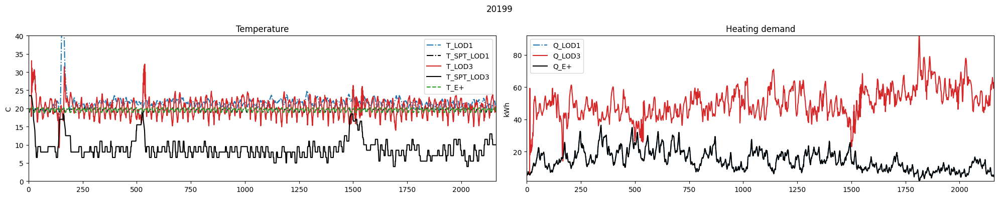

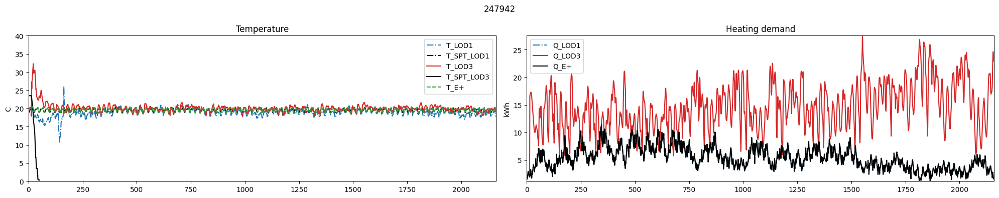

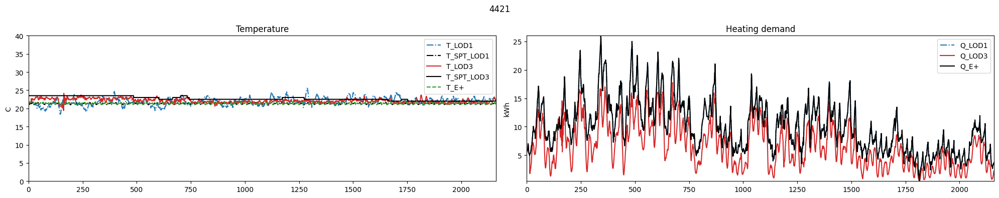

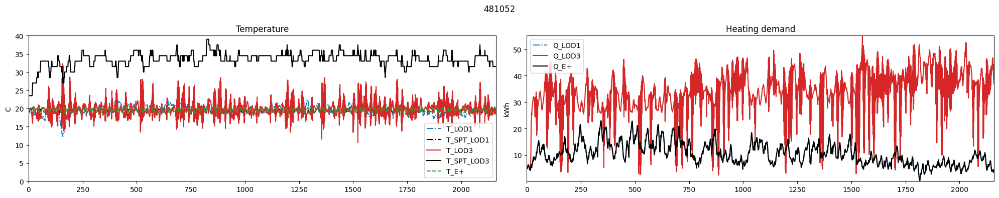

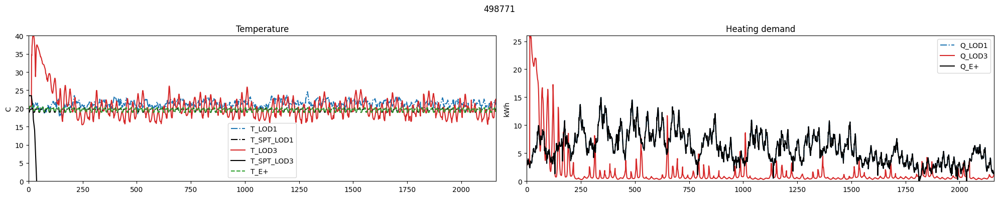

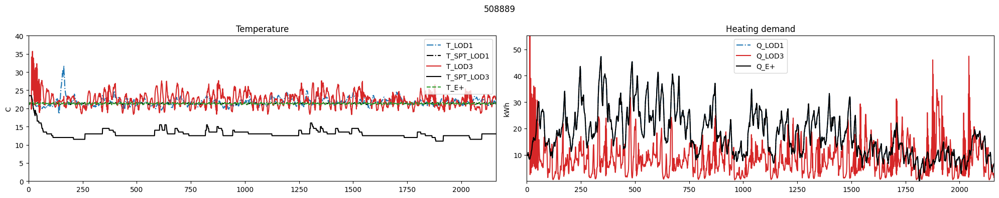

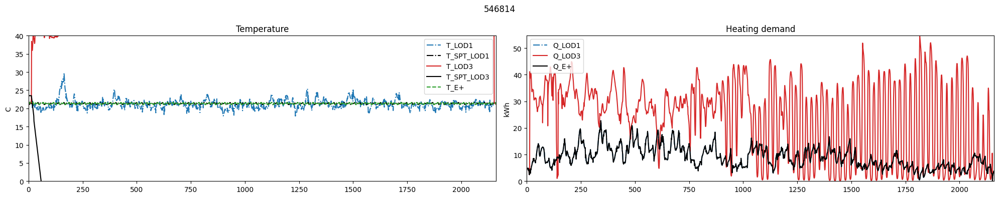

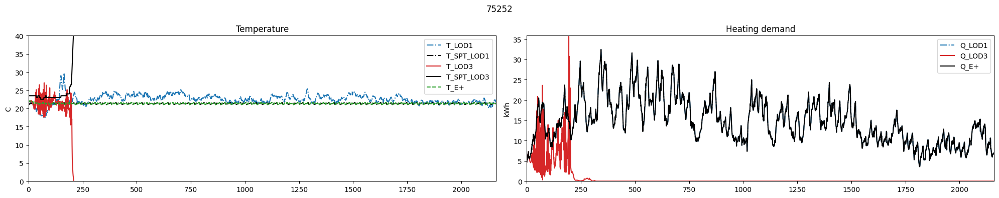

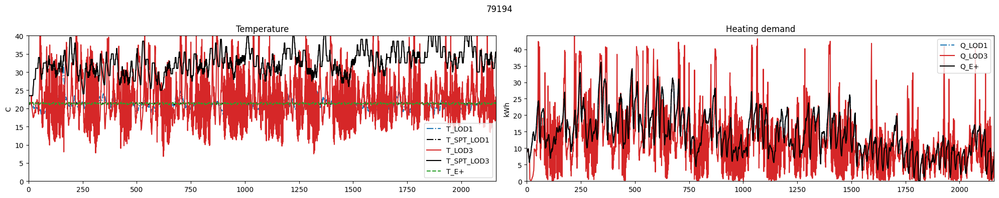

In [40]:
for b, bdata in data_23.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

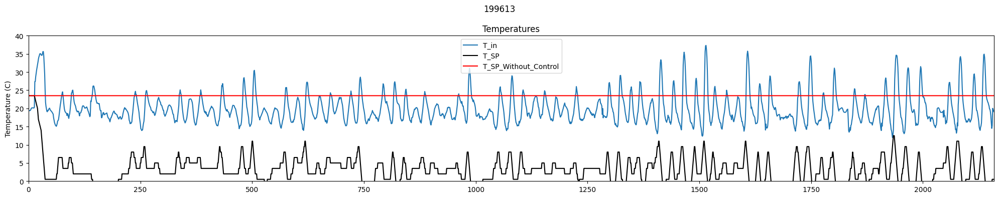

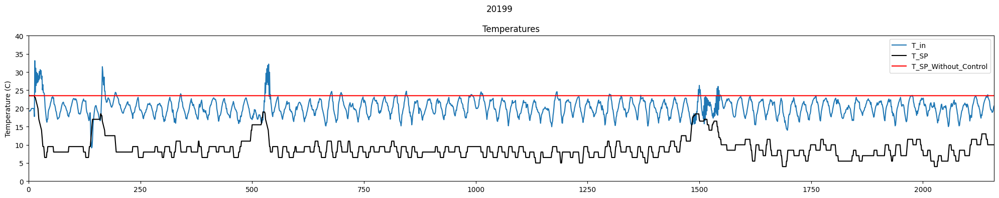

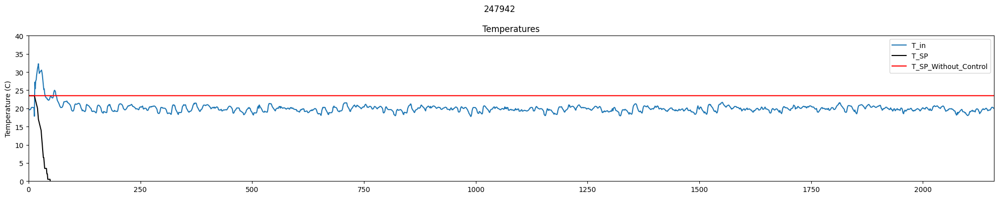

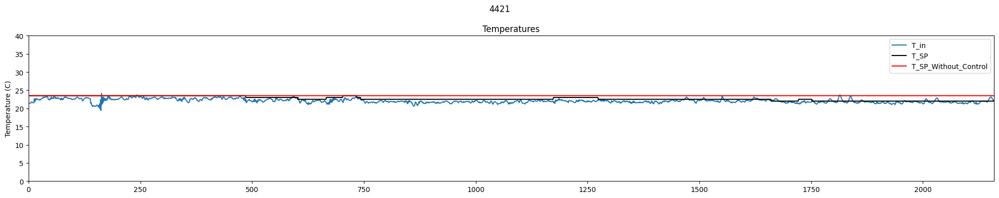

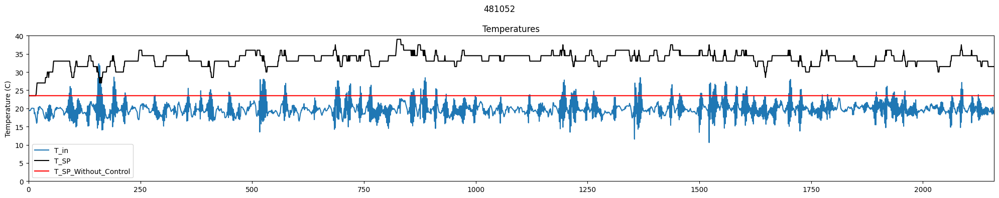

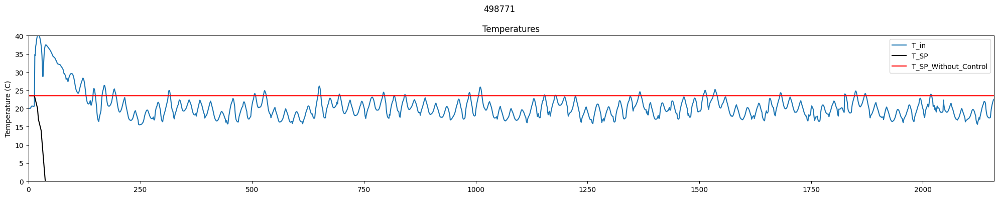

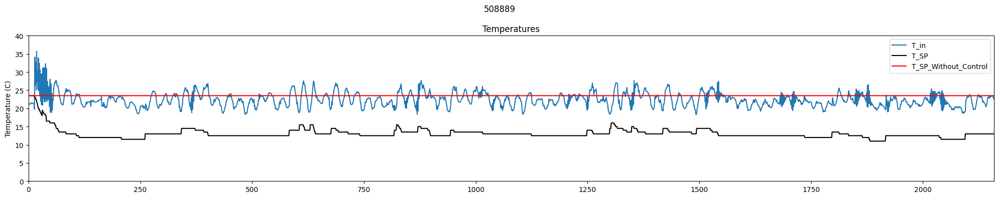

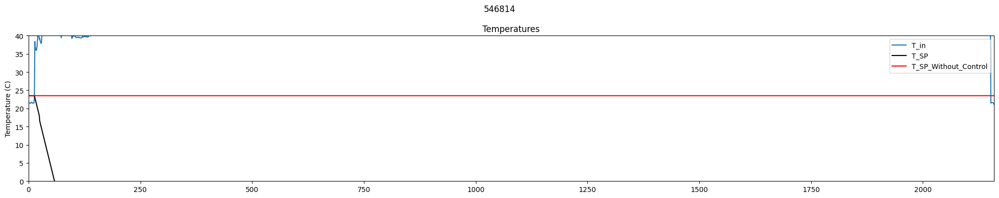

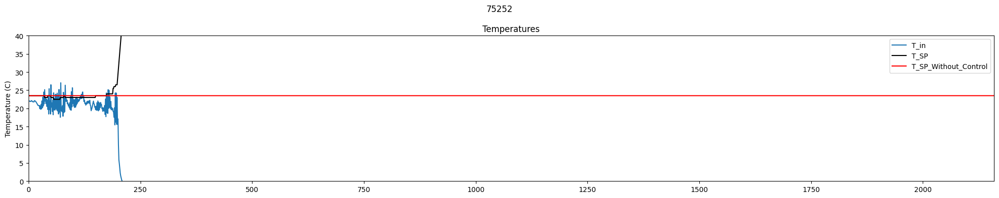

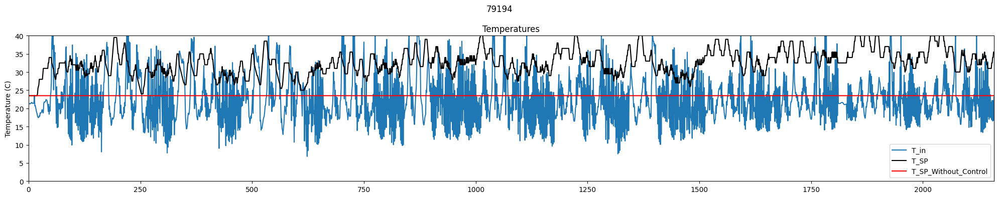

In [41]:
for b, bdata in data_23.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### TEST WITH REGULAR SP SCHEDULE: LOD 3 12.11

In [50]:
data_reg = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_reg = data_reg['bldg_name'].unique().tolist()

buildings_reg = unique_values_in_order_reg
data_reg = data_reg[data_reg['bldg_name'].isin(buildings_reg)].copy()
data_reg['lod'] = data_reg['id'].str.split('-', expand=True)[0]

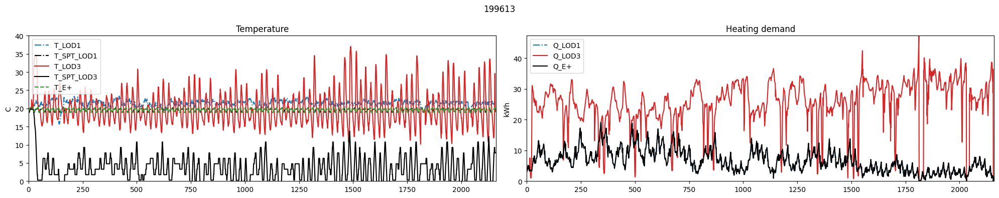

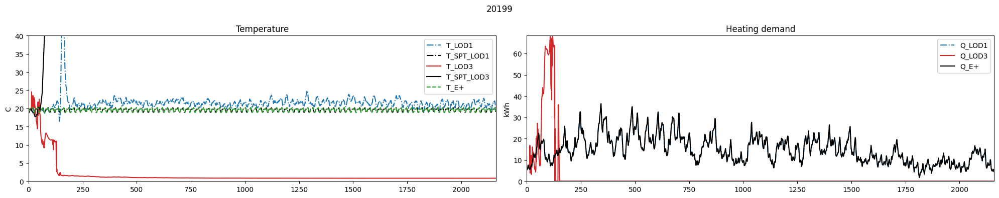

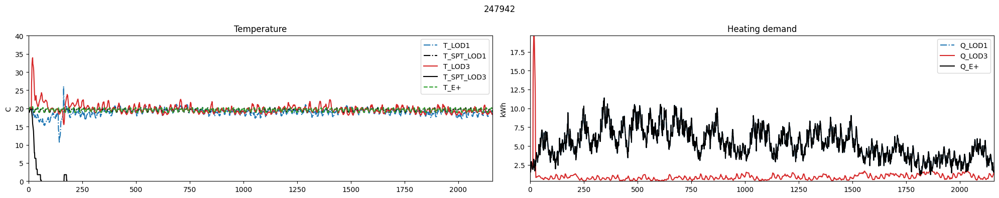

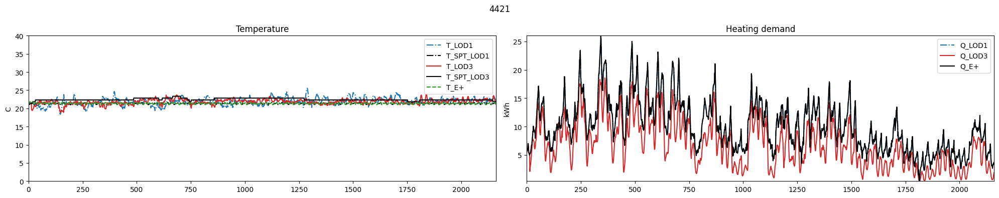

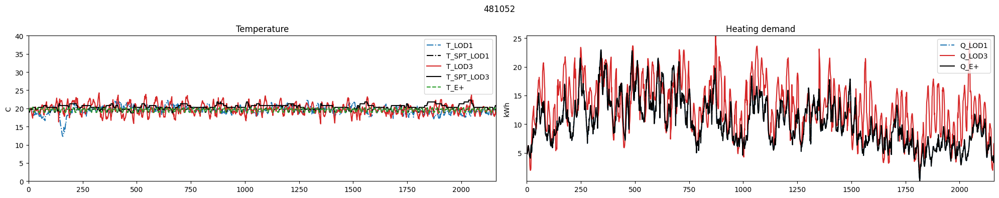

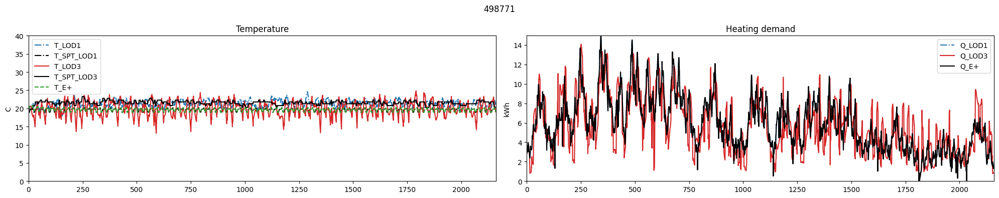

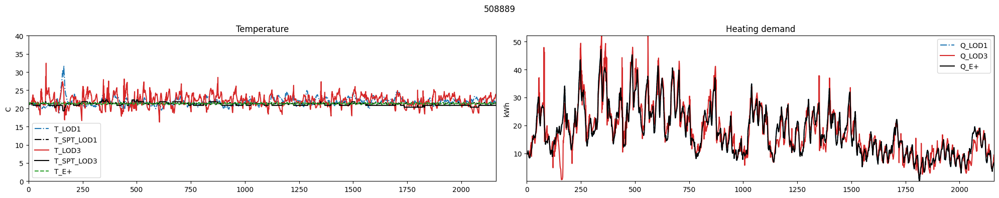

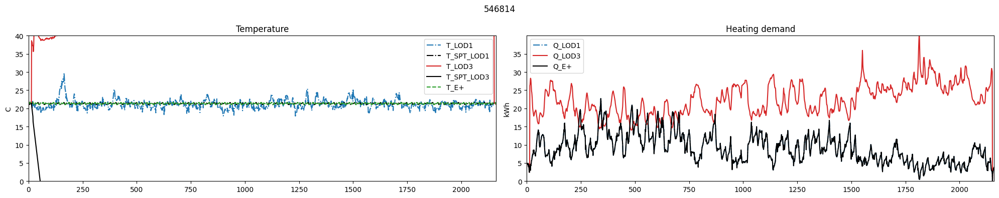

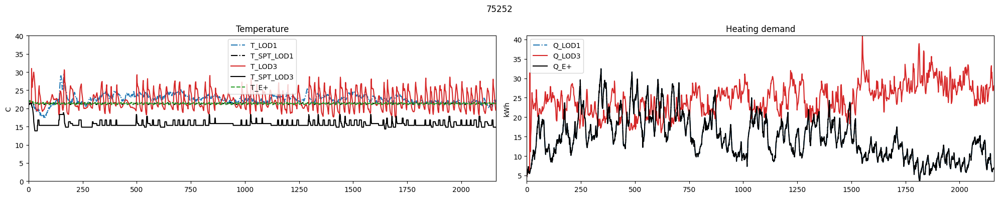

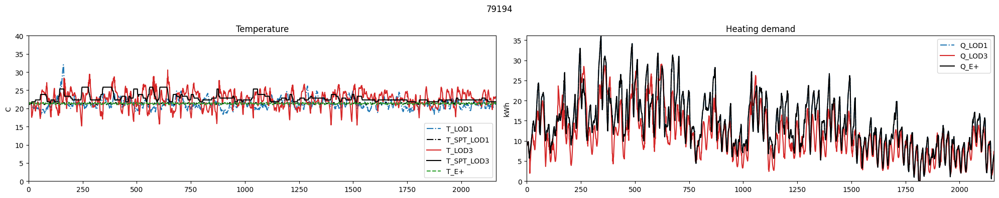

In [51]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

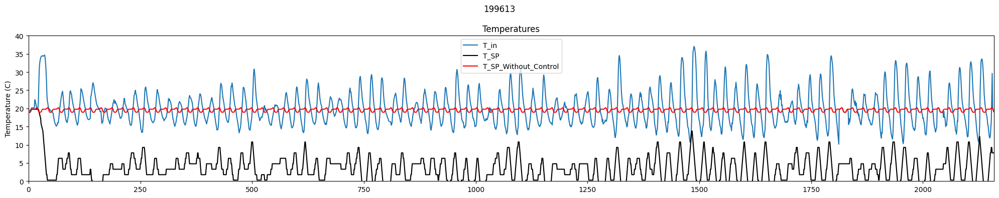

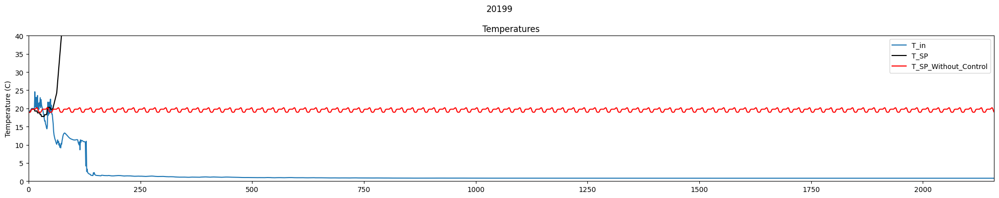

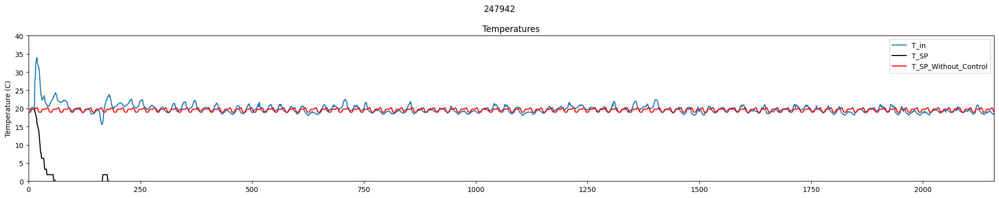

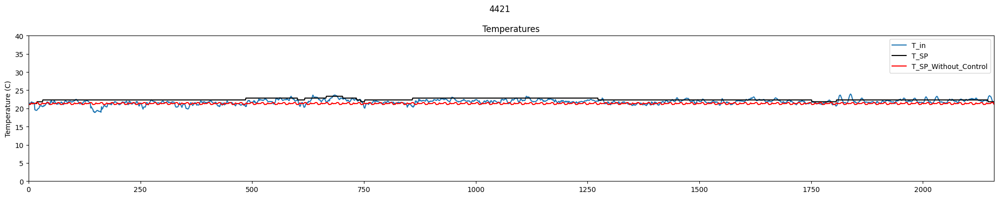

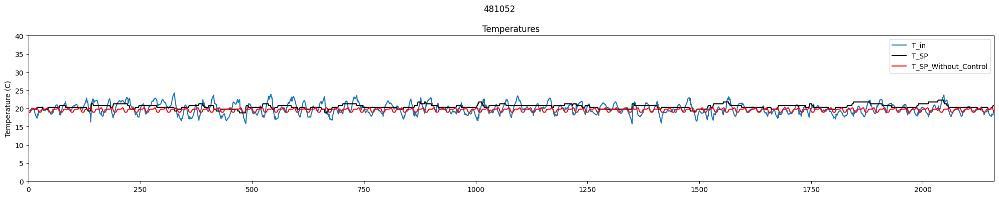

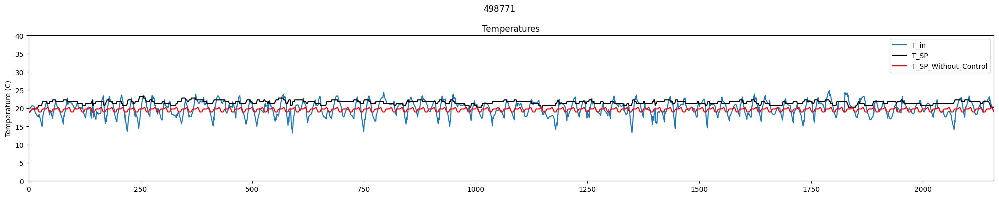

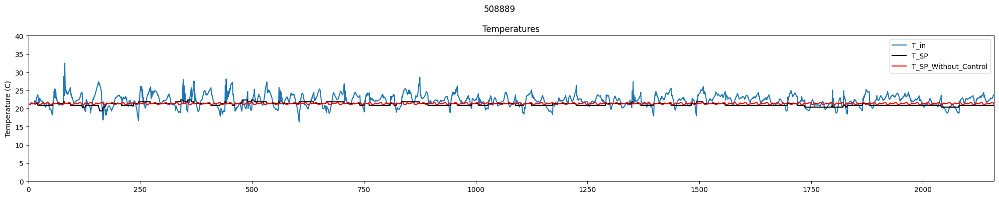

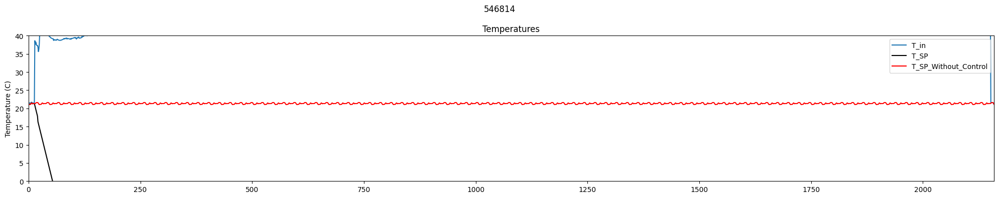

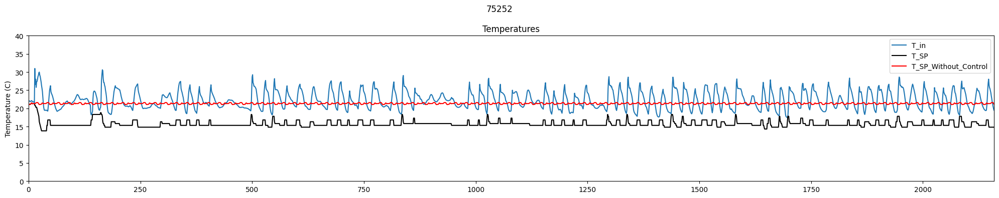

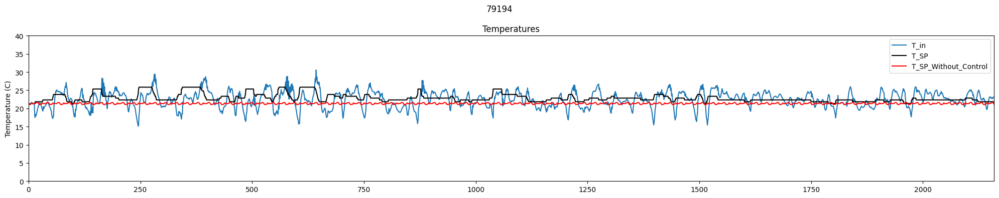

In [52]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### TEST WITH REGULAR SP SCHEDULE: LOD 3 12.21 NEW LSTMS

In [10]:
data_reg = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_reg = data_reg['bldg_name'].unique().tolist()

buildings_reg = unique_values_in_order_reg
data_reg = data_reg[data_reg['bldg_name'].isin(buildings_reg)].copy()
data_reg['lod'] = data_reg['id'].str.split('-', expand=True)[0]

KeyError: 'random_seed'

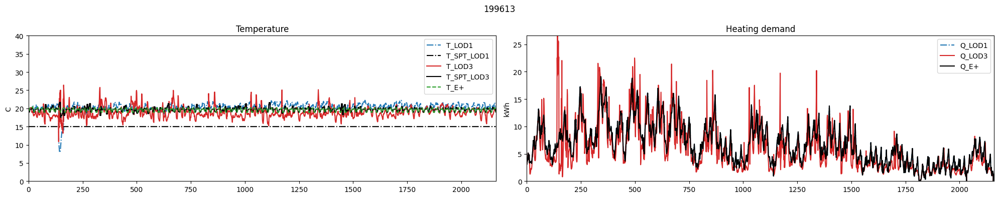

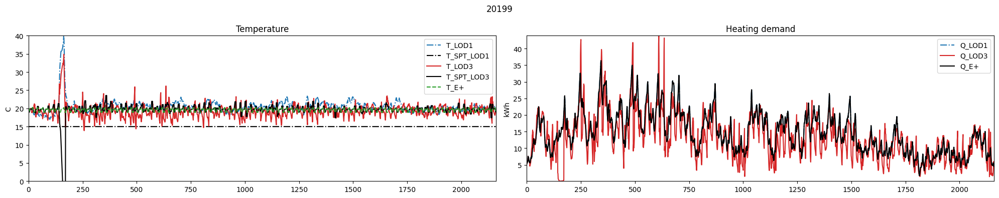

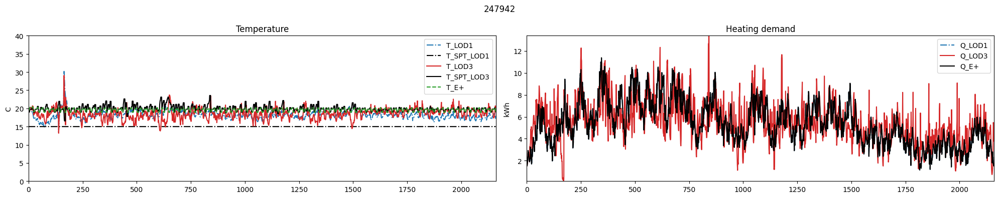

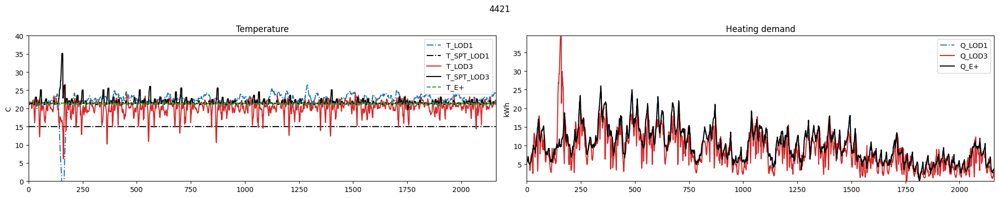

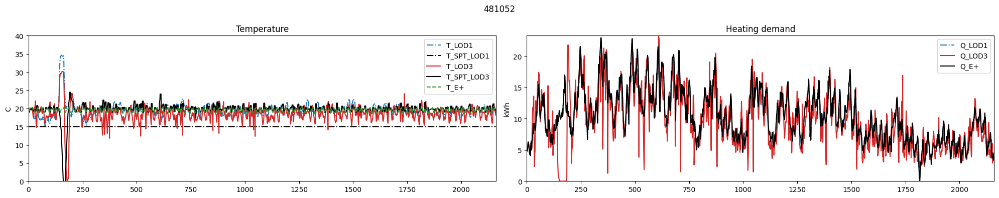

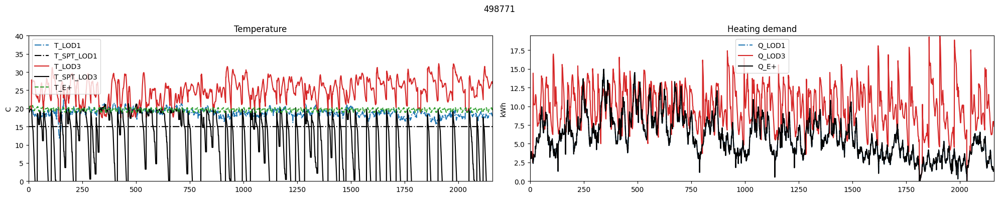

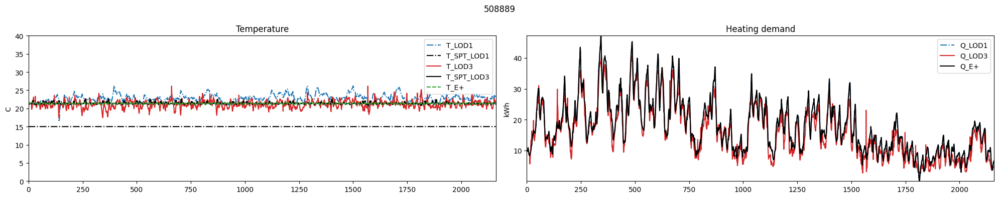

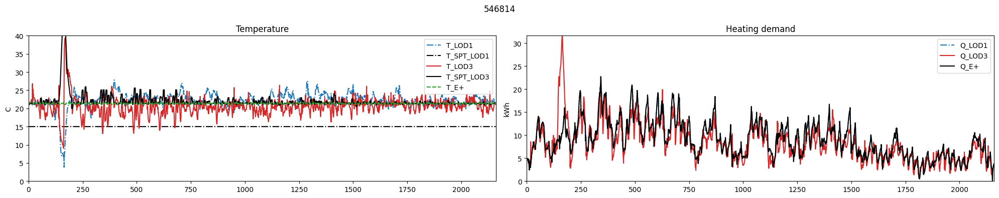

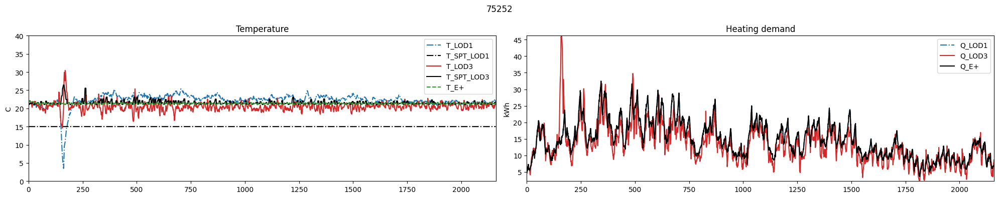

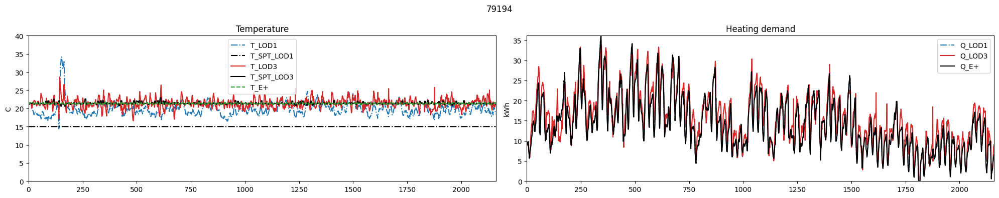

In [3]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

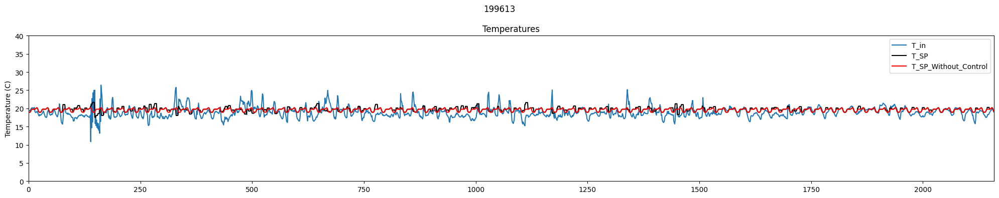

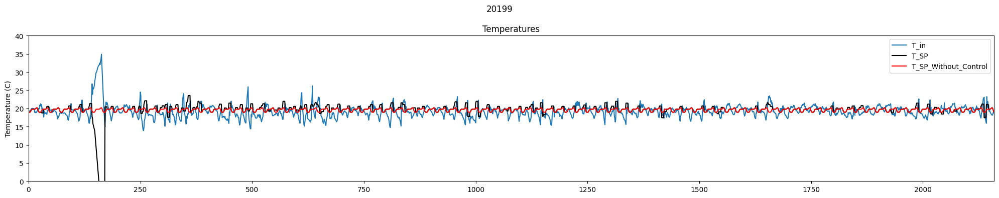

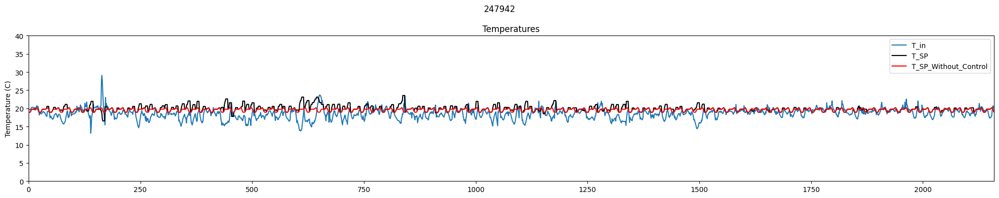

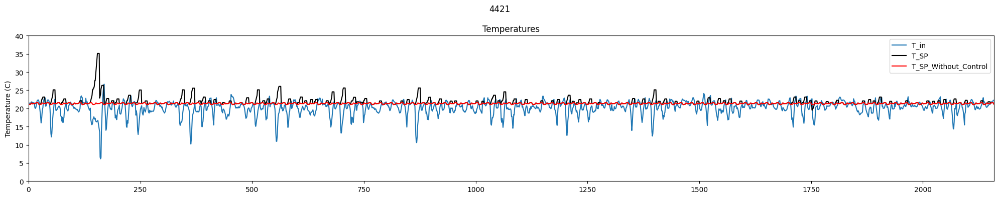

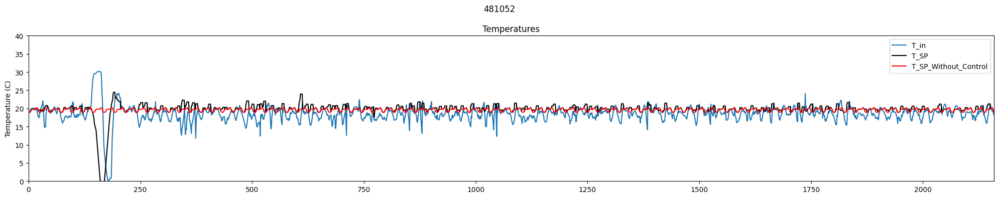

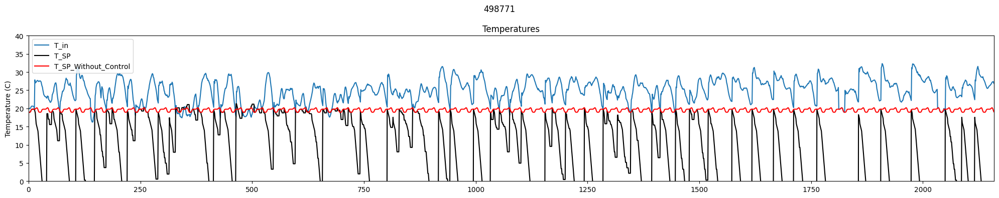

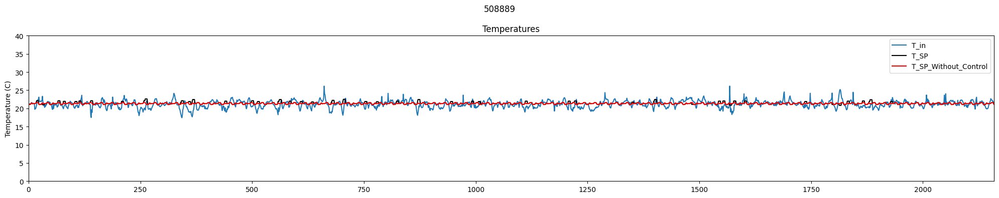

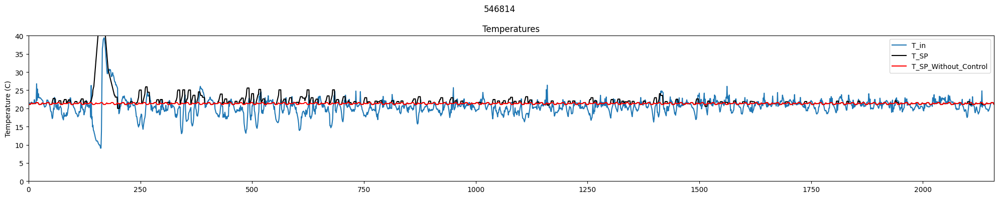

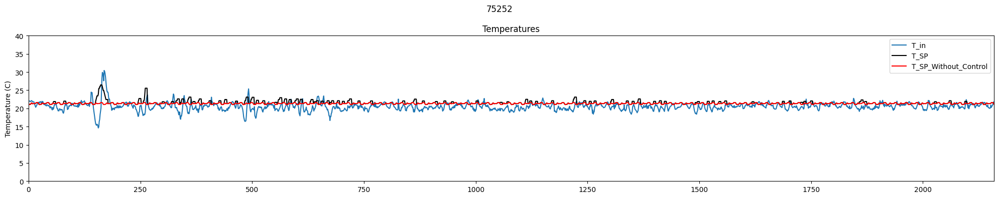

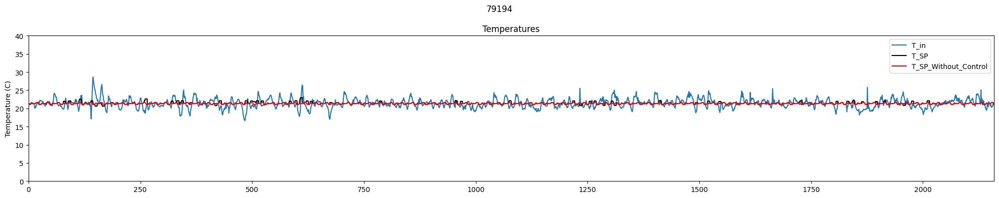

In [4]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### TEST LOD 1.24: Reward Function = cost + discomfort

In [2]:
data_124 = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_1-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_2-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_3-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_4-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_5-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_6-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_7-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_8-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_9-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-discomfortpenaltyandconsumptionpenalty-building_10-final-2022', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_reg = data_124['bldg_name'].unique().tolist()

buildings_reg = unique_values_in_order_reg
data_124 = data_124[data_124['bldg_name'].isin(buildings_reg)].copy()
data_124['lod'] = data_124['id'].str.split('-', expand=True)[0]

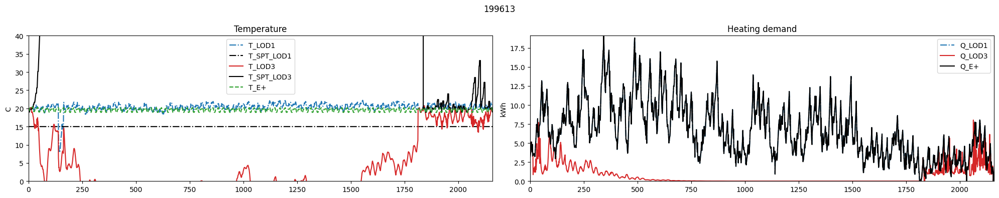

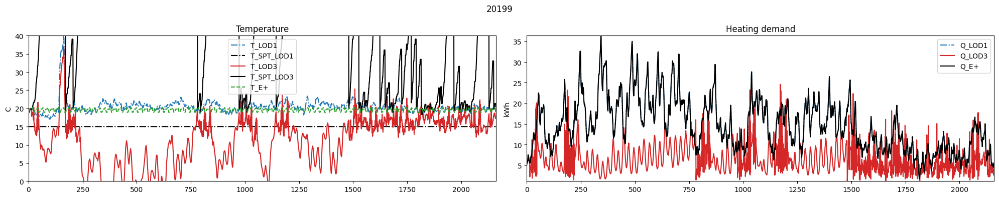

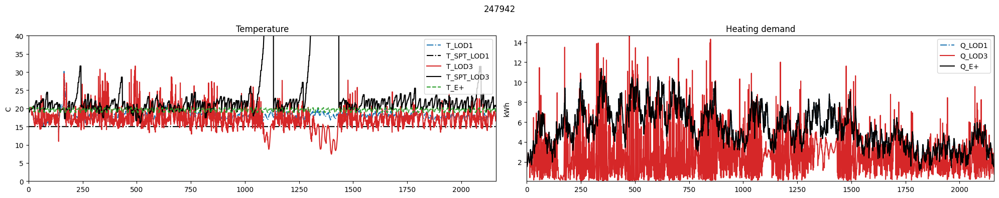

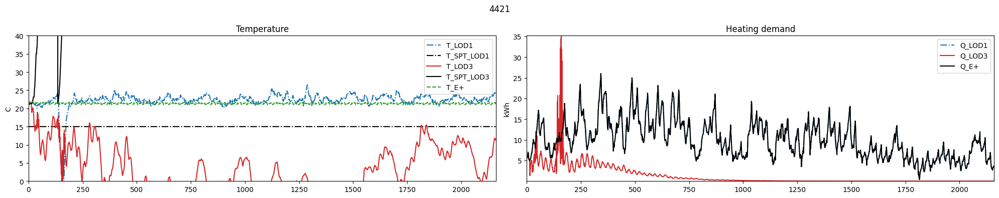

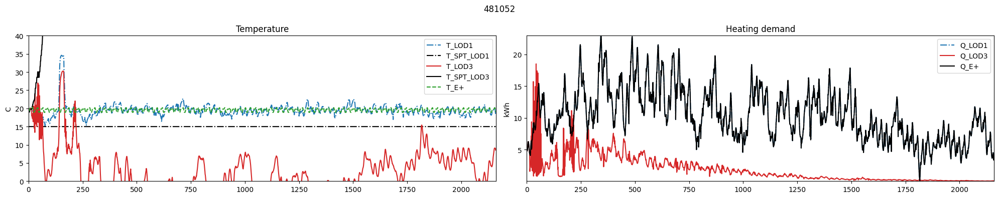

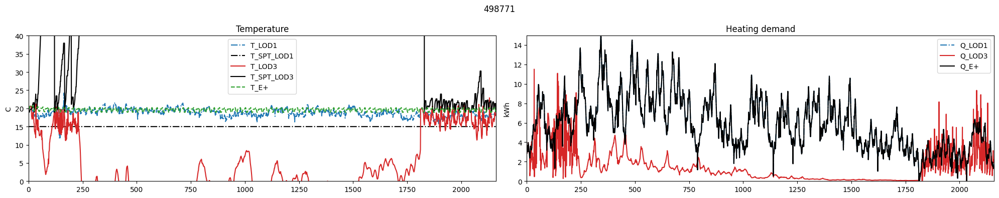

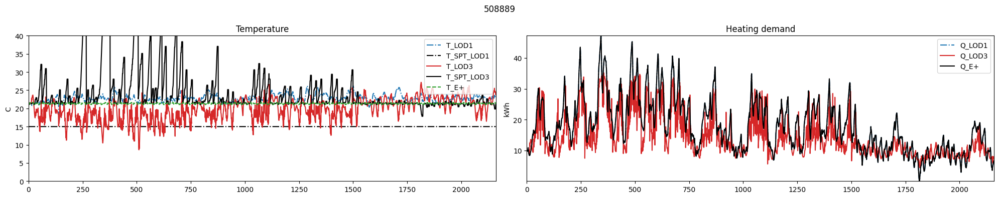

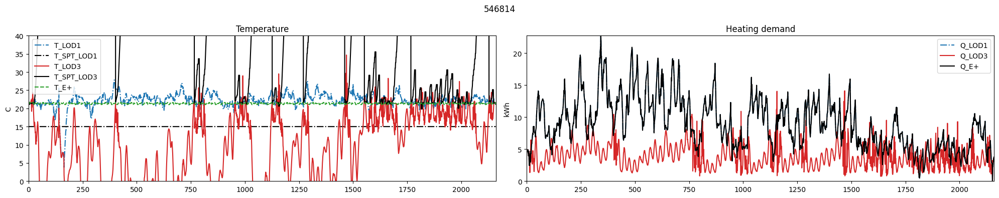

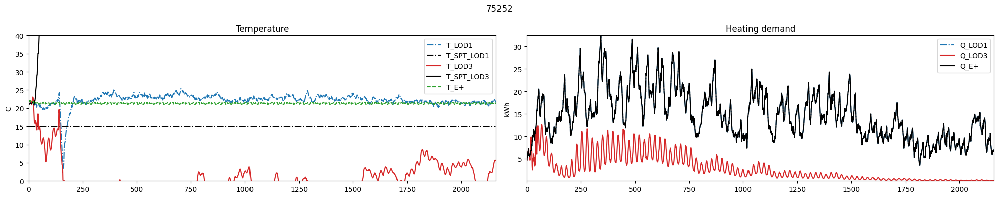

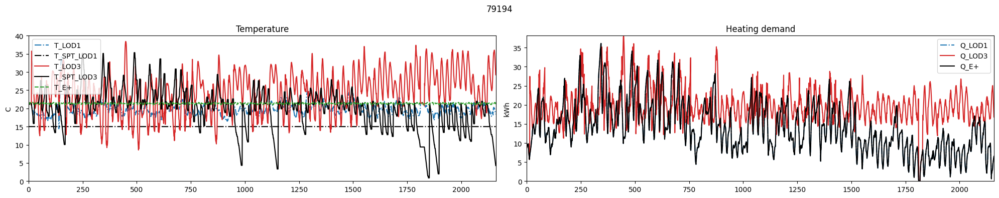

In [4]:
for b, bdata in data_124.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

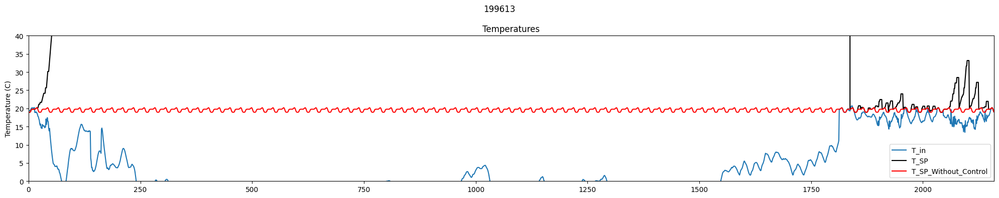

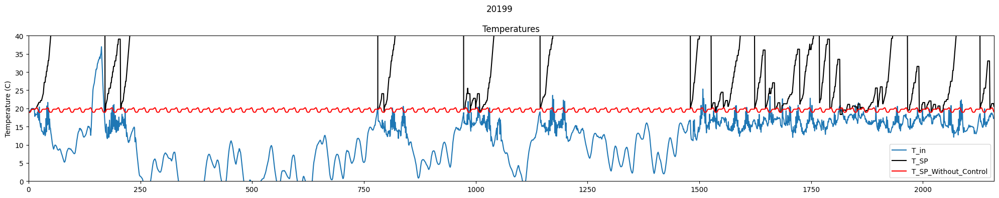

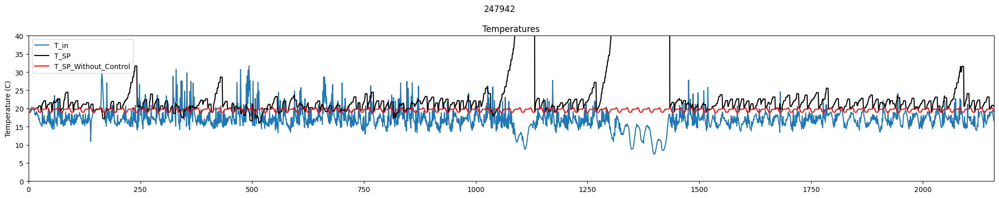

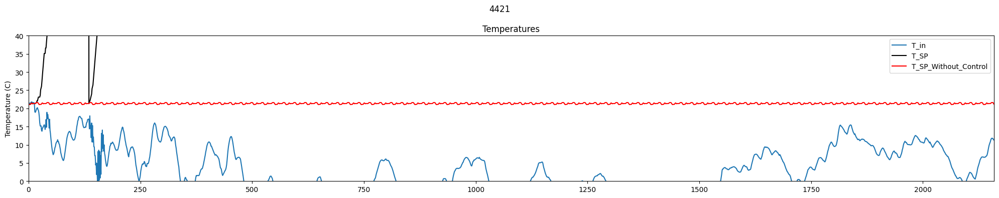

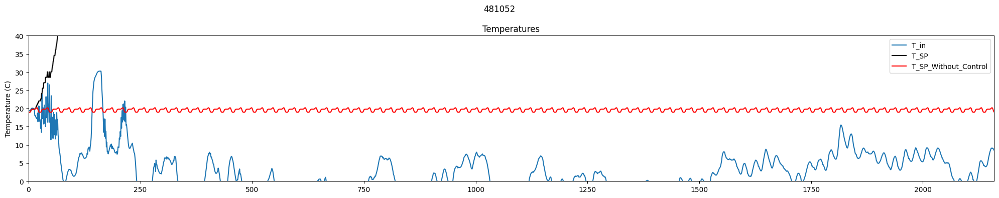

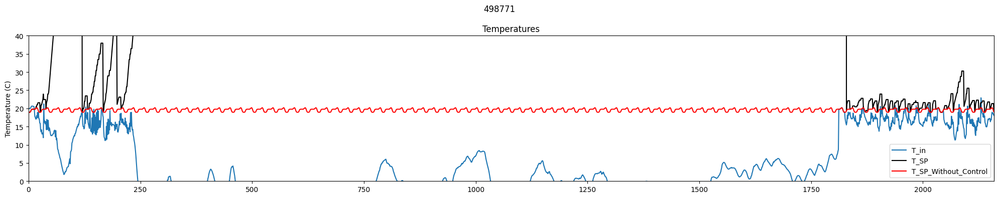

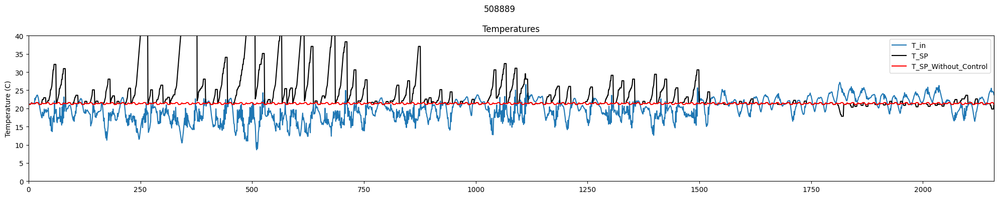

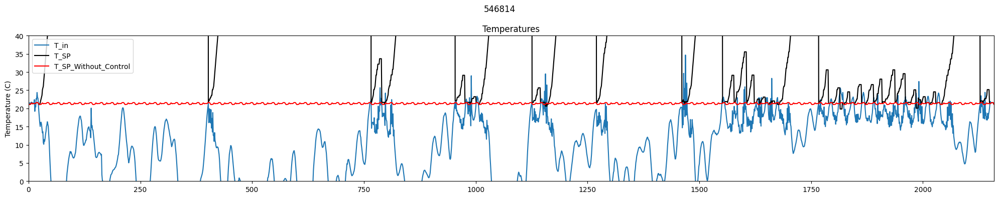

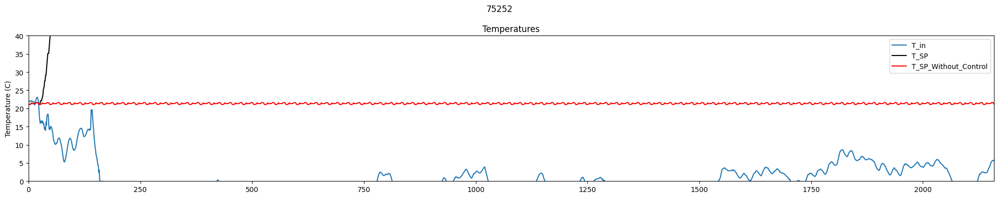

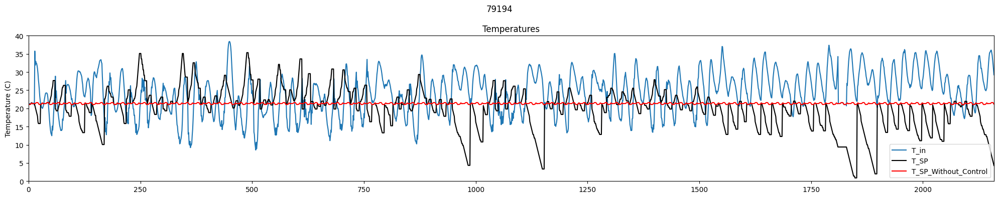

In [6]:
for b, bdata in data_124.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

### 1.30: With DR SPs

In [7]:
data_reg = pd.concat(
    [DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json', 'time_series'),
     DataHandler.get_concat_data('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022', 'time_series')],
    ignore_index=True)

unique_values_in_order_reg = data_reg['bldg_name'].unique().tolist()

buildings_reg = unique_values_in_order_reg
data_reg = data_reg[data_reg['bldg_name'].isin(buildings_reg)].copy()
data_reg['lod'] = data_reg['id'].str.split('-', expand=True)[0]
data_124['lod'] = data_124['id'].str.split('-', expand=True)[0]

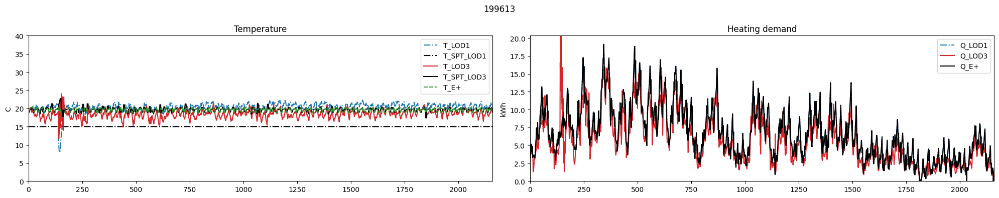

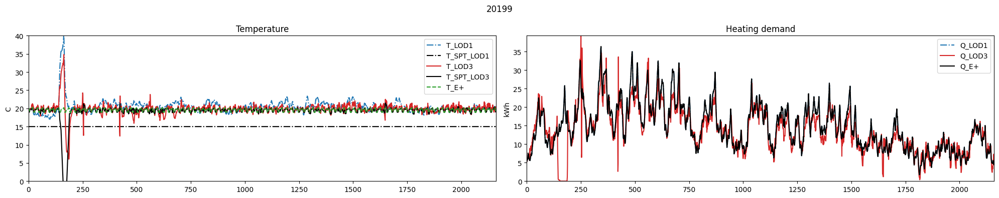

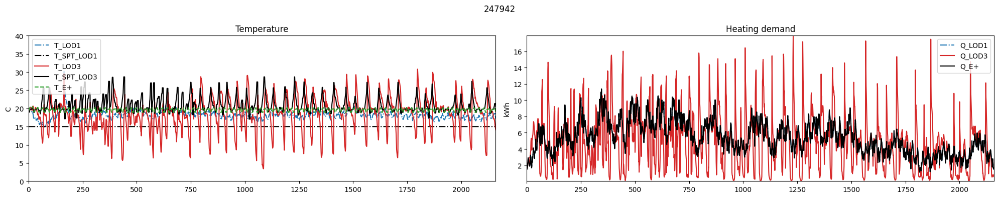

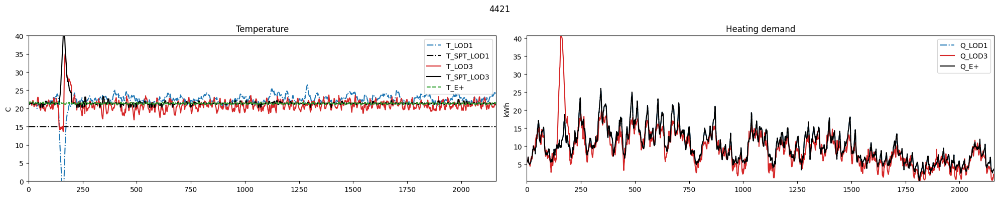

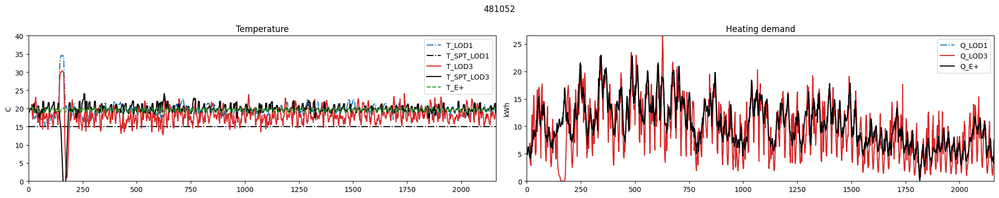

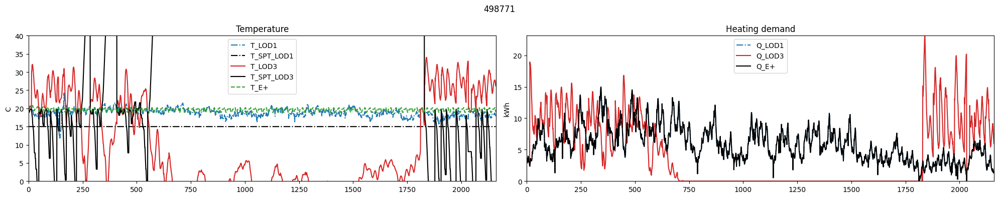

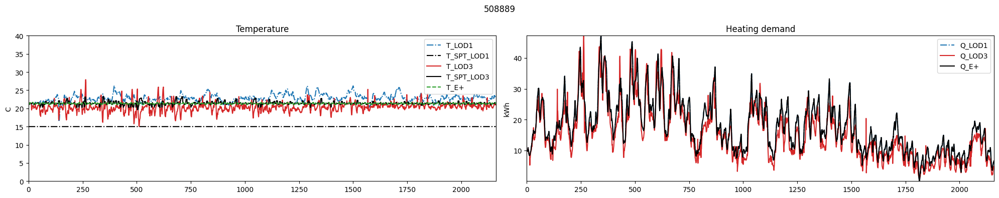

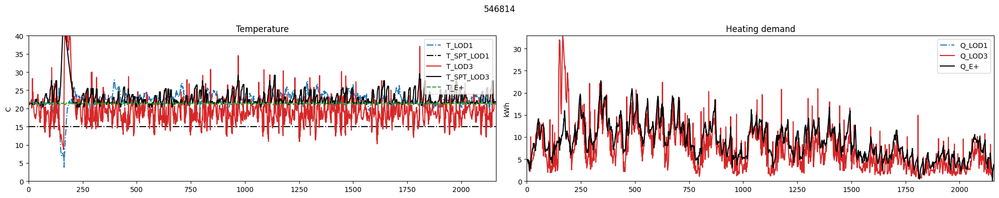

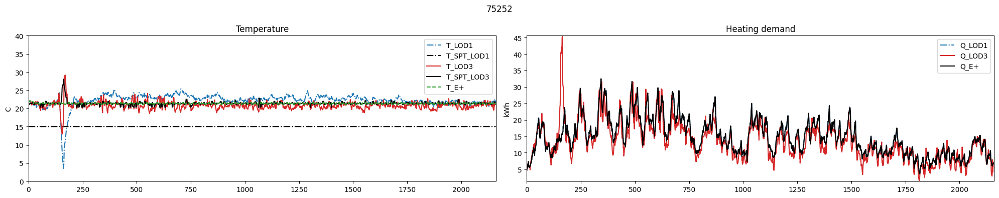

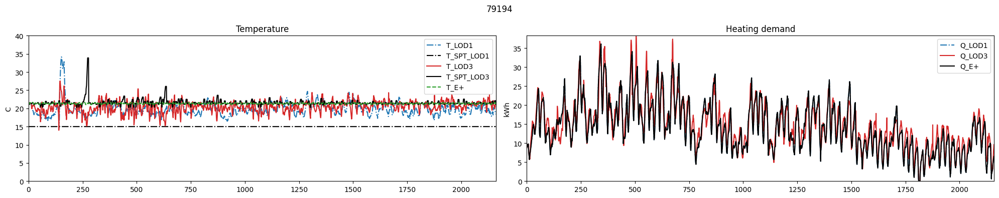

In [8]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, 2, figsize=(20, 4))
    lod1data = bdata[bdata['lod']=='lod_1'].copy()
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod1data['time_step'].tolist()

    # temperature
    y1 = lod1data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod1data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y4 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y5 = lod3data['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    fig.axes[0].plot(x, y1, label='T_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SPT_LOD1', color='black', linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_LOD3', color='tab:red', linestyle='-')
    fig.axes[0].plot(x, y4, label='T_SPT_LOD3', color='black', linestyle='-')
    fig.axes[0].plot(x, y5, label='T_E+', color='tab:green', linestyle='--')
    fig.axes[0].set_title('Temperature')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('C')
    fig.axes[0].margins(0)
    fig.axes[0].legend()
    

    # demand
    y1 = lod1data['heating_demand'].tolist()
    y2 = lod3data['heating_demand'].tolist()
    y3 = lod3data['heating_demand_without_partial_load'].tolist()
    fig.axes[1].plot(x, y1, label='Q_LOD1', color='tab:blue', linestyle='-.')
    fig.axes[1].plot(x, y2, label='Q_LOD3', color='tab:red', linestyle='-')
    fig.axes[1].plot(x, y3, label='Q_E+', color='black', linestyle='-')
    fig.axes[1].set_title('Heating demand')
    fig.axes[1].set_ylabel('kWh')
    fig.axes[1].margins(0)
    fig.axes[1].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

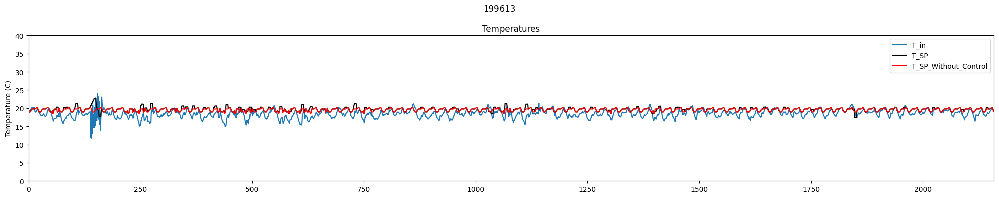

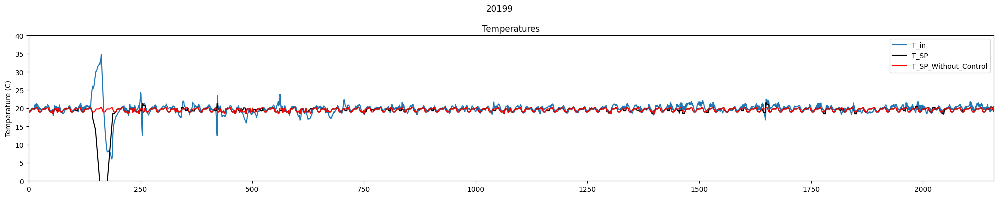

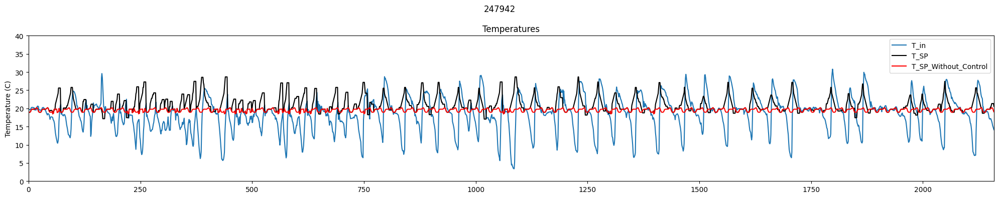

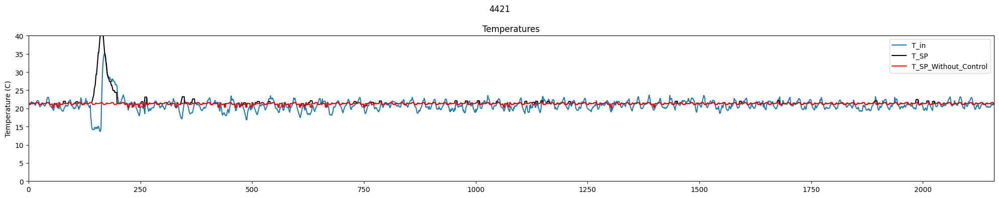

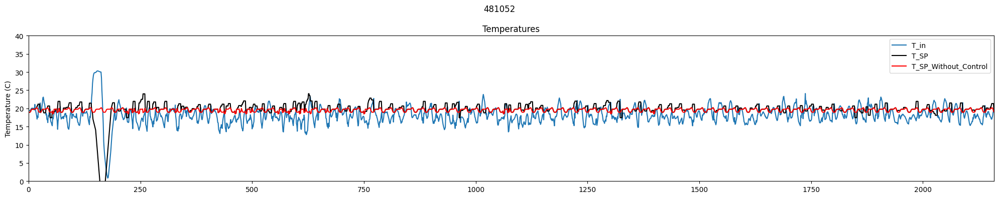

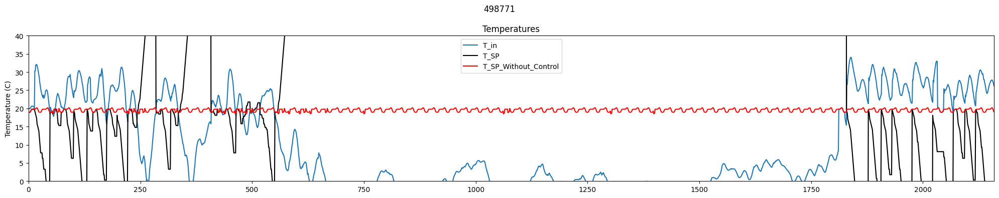

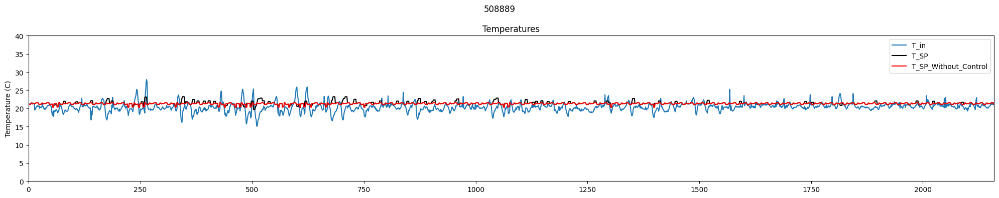

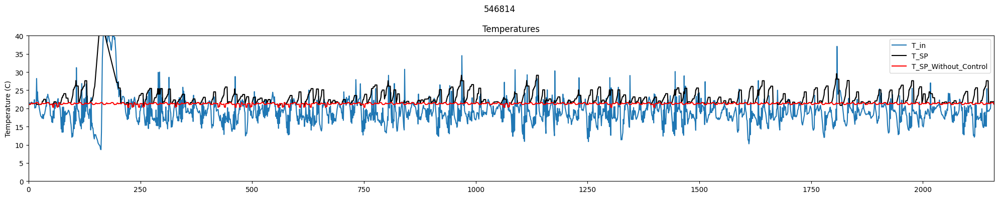

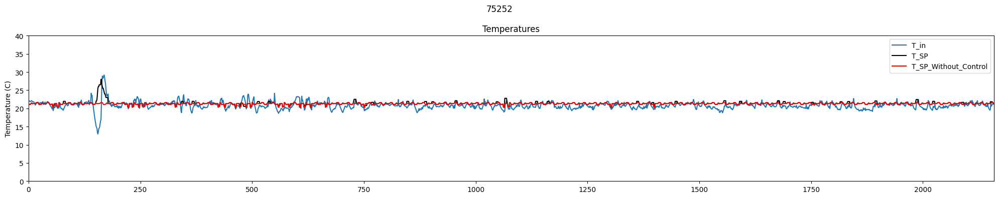

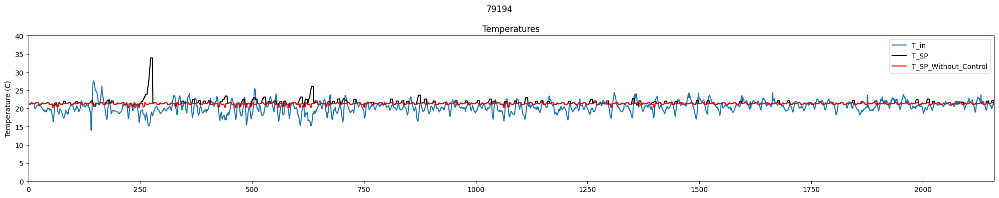

In [9]:
for b, bdata in data_reg.groupby('bldg_name'):
    fig, axs = plt.subplots(1, figsize=(20, 4))
    lod3data = bdata[bdata['lod']=='lod_3'].copy()
    x = lod3data['time_step'].tolist()

    # temperature
    y1 = lod3data['indoor_dry_bulb_temperature'].tolist()
    y2 = lod3data['indoor_dry_bulb_temperature_set_point'].tolist()
    y3 = lod3data['indoor_dry_bulb_temperature_set_point_without_control'].tolist()
    fig.axes[0].plot(x, y1, label='T_in', color='tab:blue') #linestyle='-.')
    fig.axes[0].plot(x, y2, label='T_SP', color='black') #linestyle='-.')
    fig.axes[0].plot(x, y3, label='T_SP_Without_Control', color='red') #linestyle='-.')


    fig.axes[0].set_title('Temperatures')
    fig.axes[0].set_ylim(0,40)
    fig.axes[0].set_ylabel('Temperature (C)')
    fig.axes[0].margins(0)
    fig.axes[0].legend()

    fig.suptitle(b)
    plt.tight_layout()
    plt.show()

In [10]:
plot_data = data_reg.copy()

KeyError: 'variable'

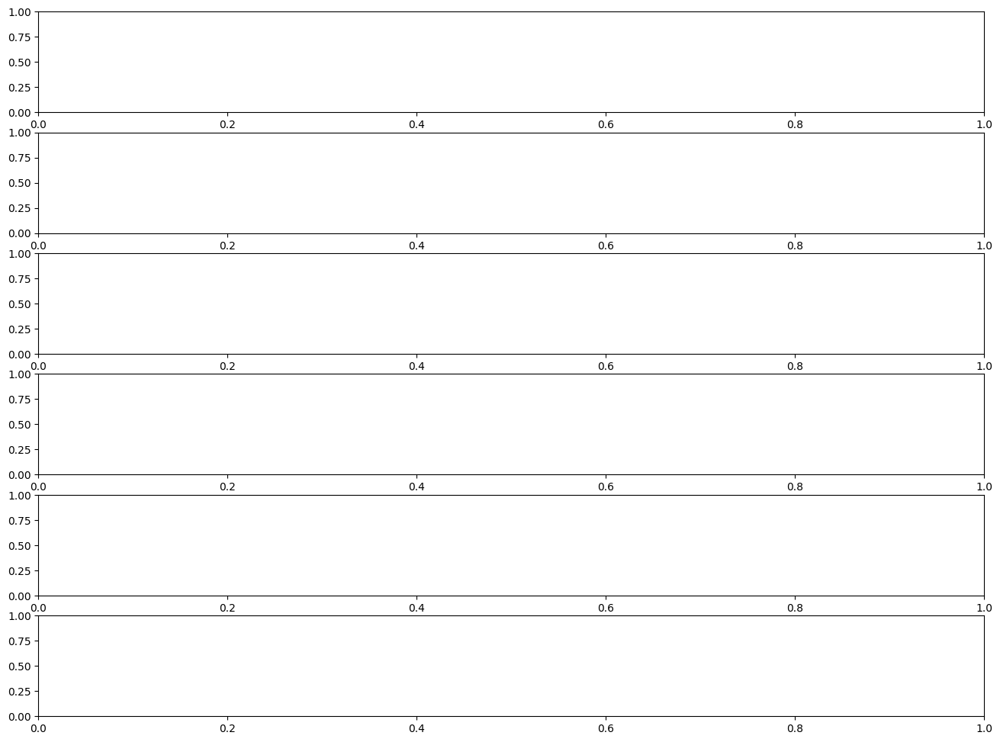

In [12]:
variables = ['net_electricity_consumption', 'indoor_dry_bulb_temperature', 'indoor_dry_bulb_temperature_set_point', 'indoor_dry_bulb_temperature_delta', 'heating_demand', 'occupant_count']
plot_data['indoor_dry_bulb_temperature_delta'] = plot_data['indoor_dry_bulb_temperature'] - plot_data['indoor_dry_bulb_temperature_set_point']
#plot_data = plot_data[(plot_data['bldg_name']==BLDG_NAME)].melt(
#    id_vars=['lod', 'time_step', 'year'],
#    value_vars=variables
#).sort_values('time_step')
row_count = len(variables)
column_count = 1
fig, _ = plt.subplots(row_count, column_count, figsize=(16, 2*row_count))

for i, (ax, v) in enumerate(zip(fig.axes, variables)):
    for l, ldata in plot_data[plot_data['variable']==v].groupby('lod'):
        x = ldata['time_step'].tolist()
        y = ldata['value'].tolist()
        ax.plot(x, y, label=l)
    
    ax.legend()
    ax.set_title(v)
    ax.margins(False)
    ylim = ax.get_ylim()
    ax.set_ylim(None, ylim[1] + 0.1)

plt.tight_layout()
plt.show()

In [14]:
key = 'occupant_interaction_indoor_dry_bulb_temperature_set_point_delta_summary'
print(plot_data.keys())
delta_data_list = []

Index(['bldg_name', 'net_electricity_consumption',
       'net_electricity_consumption_without_storage',
       'net_electricity_consumption_without_storage_and_partial_load',
       'net_electricity_consumption_without_storage_and_partial_load_and_pv',
       'indoor_dry_bulb_temperature',
       'indoor_dry_bulb_temperature_without_partial_load',
       'indoor_dry_bulb_temperature_set_point',
       'indoor_dry_bulb_temperature_set_point_without_control',
       'occupant_count', 'heating_electricity_consumption', 'heating_demand',
       'heating_demand_without_partial_load', 'dhw_electricity_consumption',
       'dhw_demand', 'non_shiftable_load',
       'non_shiftable_load_electricity_consumption',
       'energy_to_non_shiftable_load', 'energy_from_dhw_device',
       'energy_from_heating_device', 'occupant_a_increase',
       'occupant_b_increase', 'occupant_a_decrease', 'occupant_b_decrease',
       'occupant_increase_setpoint_probability',
       'occupant_decrease_setpoint_p

In [24]:
plot_data.iloc[10533,:]

bldg_name                                                                                                         199613
net_electricity_consumption                                                                                       2.9317
net_electricity_consumption_without_storage                                                                       2.9317
net_electricity_consumption_without_storage_and_partial_load                                                    2.906192
net_electricity_consumption_without_storage_and_partial_load_and_pv                                             2.906192
indoor_dry_bulb_temperature                                                                                    19.329809
indoor_dry_bulb_temperature_without_partial_load                                                               19.672066
indoor_dry_bulb_temperature_set_point                                                                          19.666666
indoor_dry_bulb_temperature_set_

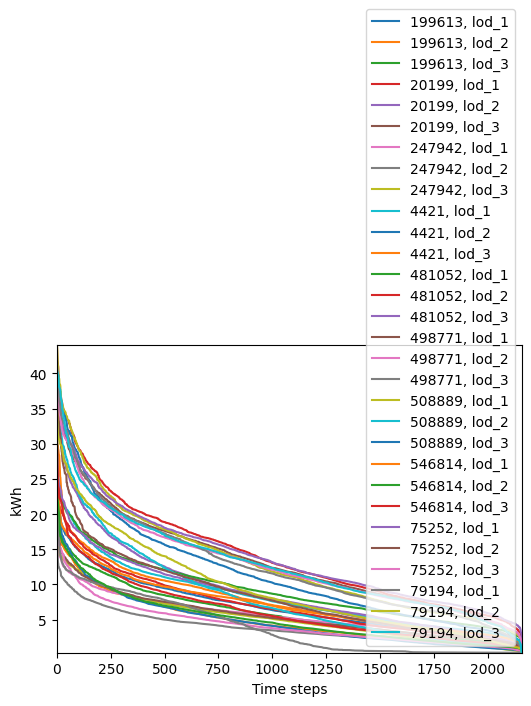

In [25]:
# Assuming 'data' is already defined and includes 'bldg_name', 'time_step', 'lod', and 'net_electricity_consumption'
#time_step_start = # Define your time_step_start value here

time_step_start = 0

# Filter data for the time_step condition
data = plot_data[plot_data['time_step'] >= time_step_start].copy()

fig, ax = plt.subplots(1, 1, figsize=(6, 4))

# Adjusted groupby to include both 'bldg_name' and 'lod' in a list
for (bldg_name, l), ldata in data.groupby(['bldg_name', 'lod']):
    y = sorted(ldata['net_electricity_consumption'].tolist(), reverse=True)
    x = range(len(y))
    # Updated label to include building name and lod for clarity
    ax.plot(x, y, label=f'{bldg_name}, {l}')

ax.set_xlabel('Time steps')
ax.set_ylabel('kWh')
ax.margins(False)
ax.legend()
plt.show()

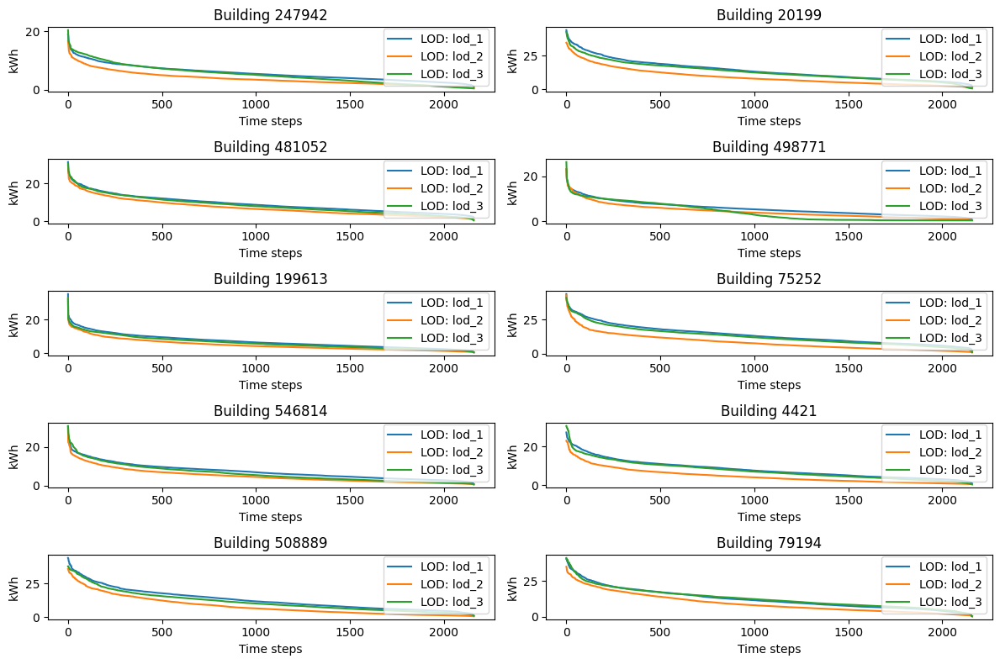

In [26]:
# Assuming 'data' is already defined and includes necessary columns
time_step_start = 0

# Filter data for the time_step condition
data = plot_data[plot_data['time_step'] >= time_step_start].copy()

# Get a unique list of buildings
buildings = data['bldg_name'].unique()
n_buildings = len(buildings)

# Define the subplot grid; you might adjust these numbers based on your preferences
n_rows = 5
n_cols = 2
if n_buildings <= n_cols:  # Adjust if there are fewer buildings to ensure no empty subplot rows
    n_rows = int(n_buildings / n_cols) + (n_buildings % n_cols > 0)

fig, axes = plt.subplots(n_rows, n_cols, figsize=(12, 8))  # Adjust figsize as necessary
fig.tight_layout(pad=3.0)  # Adjust spacing between plots

for index, bldg_name in enumerate(buildings):
    row = index // n_cols
    col = index % n_cols
    ax = axes[row, col] if n_buildings > n_cols else axes[col]  # Adjust indexing based on the grid

    # Filter data for the current building
    bldg_data = data[data['bldg_name'] == bldg_name]

    for l, ldata in bldg_data.groupby('lod'):
        y = sorted(ldata['net_electricity_consumption'].tolist(), reverse=True)
        x = range(len(y))
        ax.plot(x, y, label=f'LOD: {l}')
    
    ax.set_title(f'Building {bldg_name}')
    ax.set_xlabel('Time steps')
    ax.set_ylabel('kWh')
    ax.legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show plot
plt.show()

In [28]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 64800 entries, 0 to 64799
Data columns (total 42 columns):
 #   Column                                                               Non-Null Count  Dtype  
---  ------                                                               --------------  -----  
 0   bldg_name                                                            64800 non-null  object 
 1   net_electricity_consumption                                          64800 non-null  float64
 2   net_electricity_consumption_without_storage                          64800 non-null  float64
 3   net_electricity_consumption_without_storage_and_partial_load         64800 non-null  float64
 4   net_electricity_consumption_without_storage_and_partial_load_and_pv  64800 non-null  float64
 5   indoor_dry_bulb_temperature                                          64800 non-null  float64
 6   indoor_dry_bulb_temperature_without_partial_load                     64800 non-null  float64
 7   indo

In [30]:
data_kpis = data_reg.copy()
data_kpis['year'] = data_kpis['id'].map(lambda x: x.split('-')[-1]).astype(int)
data_kpis['level_of_detail'] = data_kpis['id'].str.split('-', expand=True)[0].str.split('_', expand=True)[1].astype(int)
data_kpis = data_kpis[
     ((data_kpis['year']==2022) & (data_kpis['level_of_detail']==1))
     | ((data_kpis['id'].str.split('-', expand=True)[6]=='building_all') & (data_kpis['level_of_detail']==3))
 ].copy()

In [32]:
data_kpis['agent_label'] = data_kpis['agent'] + '-' + data_kpis['central_agent'] + '-' + data_kpis['reward_function_name']
data_kpis.loc[data_kpis['level_of_detail']==1, 'agent_label'] = 'LOD1'
value_vars = [c for c in data_kpis.columns if c in DataHandler.KPI_LABELS.keys()]
data_kpis = data_kpis.melt(id_vars=['agent_label', 'id', 'environment'], value_vars=['discomfort_proportion'])
data_kpis['value'] = pd.to_numeric(data_kpis['value'])

# for e, edata in data.groupby('environment'):
#     fig, ax = plt.subplots(1, 1, figsize=(4, 2))
#     sns.barplot(
#         x='value',
#         y='id',
#         data=edata,
#         ax=ax,
#     )
#     ax.set_title(e)
#     ax.set_xlabel('Uncomfortable hours/Total hours')
#     ax.set_ylabel('Agent')
#     plt.show()

KeyError: "The following 'value_vars' are not present in the DataFrame: ['discomfort_proportion']"

In [39]:
data_results = pd.concat(
    [DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_3-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_1-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_2-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_3-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_4-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_5-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_6-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_7-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_8-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_9-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_2-stable_baselines3-sac-norbc-centralized-comfortreward-building_10-final-2022.json'),
     DataHandler.get_weighted_evaluation('lod_1-citylearn-rbc-norbc-centralized-noreward-building_all-final-2022')],
    ignore_index=True)

KeyError: "The following 'id_vars' are not present in the DataFrame: ['phase']"

In [15]:
BLDG_NAME = '481052'

In [16]:
for k, v in plot_data.items():
    for i, d in enumerate(v[key][BLDG_NAME][2:-1]):
        d = pd.DataFrame(d).T
        d.columns = ['delta', 'count']
        d['episode'] = i
        d['random_seed'] = v['random_seed']
        delta_data_list.append(d)

delta_data = pd.concat(delta_data_list, ignore_index=True)
delta_data = delta_data[delta_data['delta']!=0.0].copy()

plot_data = delta_data.groupby(['random_seed', 'episode'])[['count']].sum().reset_index()
fig, ax = plt.subplots(1, 1, figsize=(6, 2.5))
y1 = plot_data.groupby('episode')['count'].min().tolist()
y2 = plot_data.groupby('episode')['count'].max().tolist()
x = range(len(y1))
ax.fill_between(x, y1, y2)
ax.xaxis.set_major_locator(ticker.MultipleLocator(10))
ax.set_xlabel('Episode')
ax.set_ylabel('Number of interactions')
ax.margins(False)

for s in ['right', 'top']:
    ax.spines[s].set_visible(False)
    
#plt.savefig(os.path.join(FIGURES_DIRECTORY, f'occupant_interaction_per_episode.png'), bbox_inches='tight', transparent=False)
plt.show()

plot_data = delta_data[delta_data['random_seed']==delta_data['random_seed'].max()].pivot(index='episode', columns='delta', values='count')
fig, ax = plt.subplots(1, 1, figsize=(6, 2.5))
plot_data.plot(kind='bar', stacked=True, ax=ax, colormap='coolwarm')
ax.set_xlabel('Episode')
ax.set_ylabel('Number of interactions')
# ax.margins(False)
ax.tick_params(axis='x', rotation=0)
ax.xaxis.set_major_locator(ticker.MultipleLocator(10))
ax.legend(title=r'$T^{spt, \delta}$')

for s in ['right', 'top']:
    ax.spines[s].set_visible(False)

#plt.savefig(os.path.join(FIGURES_DIRECTORY, f'occupant_setpoint_delta_per_episode.png'), bbox_inches='tight', transparent=False)
plt.show()

KeyError: 'occupant_interaction_indoor_dry_bulb_temperature_set_point_delta_summary'

In [ ]:
key = 'occupant_interaction_indoor_dry_bulb_temperature_set_point_delta_summary'
data = DataHandler.get_evaluation_summary(['building_3', '-comfortreward-', 'awc2024-o'])
print(data.keys())
delta_data_list = []

for k, v in data.items():
    for i, d in enumerate(v[key][BLDG_NAME][2:-1]):
        d = pd.DataFrame(d).T
        d.columns = ['delta', 'count']
        d['episode'] = i
        d['random_seed'] = v['random_seed']
        delta_data_list.append(d)

delta_data = pd.concat(delta_data_list, ignore_index=True)
delta_data = delta_data[delta_data['delta']!=0.0].copy()

plot_data = delta_data.groupby(['random_seed', 'episode'])[['count']].sum().reset_index()
fig, ax = plt.subplots(1, 1, figsize=(6, 2.5))
y1 = plot_data.groupby('episode')['count'].min().tolist()
y2 = plot_data.groupby('episode')['count'].max().tolist()
x = range(len(y1))
ax.fill_between(x, y1, y2)
ax.xaxis.set_major_locator(ticker.MultipleLocator(10))
ax.set_xlabel('Episode')
ax.set_ylabel('Number of interactions')
ax.margins(False)

for s in ['right', 'top']:
    ax.spines[s].set_visible(False)
    
plt.savefig(os.path.join(FIGURES_DIRECTORY, f'occupant_interaction_per_episode.png'), bbox_inches='tight', transparent=False)
plt.show()

plot_data = delta_data[delta_data['random_seed']==delta_data['random_seed'].max()].pivot(index='episode', columns='delta', values='count')
fig, ax = plt.subplots(1, 1, figsize=(6, 2.5))
plot_data.plot(kind='bar', stacked=True, ax=ax, colormap='coolwarm')
ax.set_xlabel('Episode')
ax.set_ylabel('Number of interactions')
# ax.margins(False)
ax.tick_params(axis='x', rotation=0)
ax.xaxis.set_major_locator(ticker.MultipleLocator(10))
ax.legend(title=r'$T^{spt, \delta}$')

for s in ['right', 'top']:
    ax.spines[s].set_visible(False)

plt.savefig(os.path.join(FIGURES_DIRECTORY, f'occupant_setpoint_delta_per_episode.png'), bbox_inches='tight', transparent=False)
plt.show()

In [42]:
data_test = DataHandler.get_weighted_evaluation(['building_3', '-comfortreward-'])
print(data.keys())

KeyError: "The following 'id_vars' are not present in the DataFrame: ['phase']"

In [43]:
print(output_directory)

NameError: name 'output_directory' is not defined

temperature_delta                                   \
                                 count       mean        std        min   
bldg_name bldg_index                                                      
20199     1                     2160.0   0.243401   1.744676 -14.133211   
4421      7                     2160.0  -0.443162   1.655077  -7.861502   
75252     5                     2160.0  -0.522127   1.053402  -8.364241   
79194     9                     2160.0  -0.922341   1.542329  -7.625662   
508889    8                     2160.0  -0.976170   1.220826  -6.462053   
199613    4                     2160.0  -1.127355   1.064868  -8.256617   
247942    0                     2160.0  -1.244585   4.707765 -16.187764   
481052    2                     2160.0  -1.427365   2.556451 -18.944470   
546814    6                     2160.0  -2.219424   3.773561 -12.967031   
498771    3                     2160.0 -10.352330  12.390229 -30.305696   

                                                                               
                            25%        50%       75%        max absolute_mean  
bldg_name bldg_index                                                           
20199     1           -0.151912   0.311084  0.715945  14.638599      0.243401  
4421      7           -1.195067  -0.475846  0.230786  13.925898      0.443162  
75252     5           -1.036938  -0.538486 -0.050100   8.132542      0.522127  
79194     9           -1.847924  -0.832062  0.009056   6.470552      0.922341  
508889    8           -1.583940  -0.944999 -0.395681   6.869833      0.976170  
199613    4           -1.748407  -1.070574 -0.420510   4.239132      1.127355  
247942    0           -3.772111  -0.711635  1.095081  11.513147      1.244585  
481052    2           -2.760610  -1.455257 -0.098015  10.864021      1.427365  
546814    6           -4.201401  -2.496070 -0.777404  21.337446      2.219424  
498771    3          -20.730545 -15.589124  2.833777  14.208879     10.352330

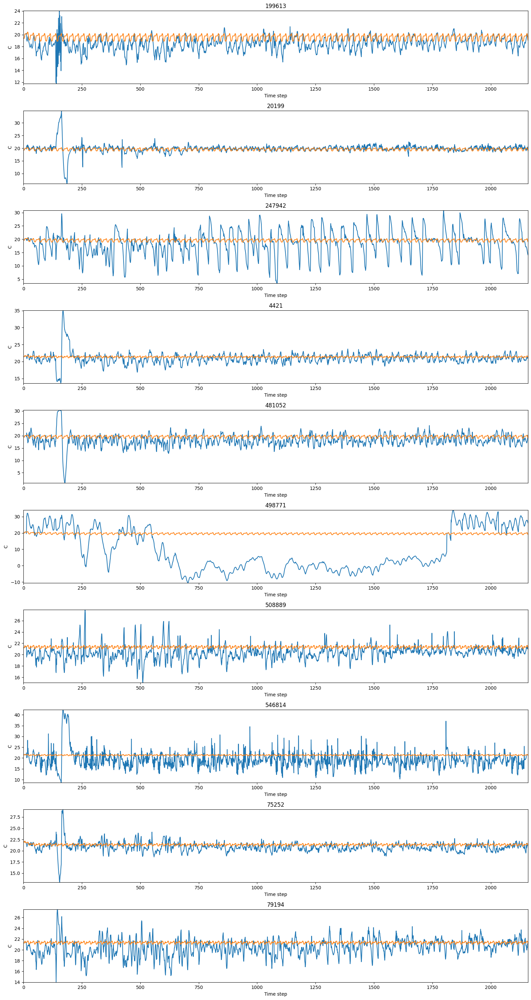

In [4]:
# find building with least LSTM error
plot_data = DataHandler.get_concat_data(['lod_3','comfortreward'], 'time_series')
building_order_in_schema = list(read_json(os.path.join(FileHandler.SCHEMA_DIRECTORY, 'schema.json'))['buildings'].keys())
building_order_in_schema = pd.DataFrame(building_order_in_schema, columns=['bldg_name'])
building_order_in_schema['bldg_index'] = building_order_in_schema.index
plot_data = plot_data.merge(building_order_in_schema, on='bldg_name', how='left')
plot_data['temperature_delta'] = plot_data['indoor_dry_bulb_temperature'] - plot_data['indoor_dry_bulb_temperature_without_partial_load']
summary_data = plot_data.groupby(['bldg_name', 'bldg_index'])[['temperature_delta']].describe()
summary_data[('temperature_delta', 'absolute_mean')] = summary_data[('temperature_delta', 'mean')].abs()
display(summary_data.sort_values(('temperature_delta', 'absolute_mean')))
buildings = plot_data['bldg_name'].unique()
row_count = len(buildings)
column_count = 1
fig, _ = plt.subplots(row_count, column_count, figsize=(16, 3*row_count))

for i, (ax, (b, bdata)) in enumerate(zip(fig.axes, plot_data.groupby('bldg_name'))):
    x = bdata['time_step'].tolist()
    y1 = bdata['indoor_dry_bulb_temperature'].tolist()
    y2 = bdata['indoor_dry_bulb_temperature_without_partial_load'].tolist()
    ax.plot(x, y1)
    ax.plot(x, y2)
    ax.set_title(b)
    ax.set_xlabel('Time step')
    ax.set_ylabel('C')
    ax.margins(False)

plt.tight_layout()
plt.show()